In [1]:
## Notebook env: brian_script_env (R kernel)

## This notebook takes out cell cylce genes from the PCA analysis done before
## It also creates a regression model to remove cell cycle effects from all genes (including cell cycle genes)

In [2]:
library(ggplot2)
library(scales)
library(parallel)
library(cvequality)
library(readxl)
library(tibble)
library(dplyr)
library(tidyr)
library(pbapply)
library(qvalue)
library(gplots)
library(stats)
library(reshape2)
library(gridExtra)
library(Seurat)
library(ggpubr)
library(ggrepel)
library(sinaplot)
library(ggforce)

## load in data
RNA_Seq_expression_raw_data <- 
read.delim("/home/ssobti/projects/heterogeneity_brian/uploaded_data/brca_tcga/data_RNA_Seq_v2_expression_median.txt", stringsAsFactors = FALSE)

#The 'all' approach to check if all values in a row are 0
check_if_not_zero <- function (vector, number = 0) {
  if (!(all (vector == number))) {
    return (TRUE) #if not zero, then returns TRUE
  }
  else{
    return(FALSE)
  }
}

#See if there are any rows that are FALSE, meaning that are actually all 0
all(as.vector(unlist(apply(RNA_Seq_expression_raw_data[,-1:-2], 1, check_if_not_zero)))) 
zero_genes = as.vector(unlist(apply(RNA_Seq_expression_raw_data[,-1:-2], 1, check_if_not_zero)))

##take out genes with no expression in any of the patients
RNA_Seq_expression_raw_data = RNA_Seq_expression_raw_data[zero_genes,]


gene_medians = apply(RNA_Seq_expression_raw_data[, -c(1,2)], 1, median)

median_df = data.frame(medians = gene_medians)
pct_genes_left = function(median_expression, cutoff){
  pct = 100*length(which(median_expression >= cutoff))/length(median_expression)
  return(pct)
}

pct_genes_left(gene_medians, 10)

### removing genes with medians < 10 keeps 72% of genes -- low expressing genes have noisy expression and confound results ###

genes_to_keep = as.numeric(gene_medians) >= 10
RNA_Seq_expression_raw_data_original = RNA_Seq_expression_raw_data
RNA_Seq_expression_raw_data = RNA_Seq_expression_raw_data[genes_to_keep,]

raw_counts = as.matrix(RNA_Seq_expression_raw_data[, -c(1,2)])
rownames(raw_counts) <- RNA_Seq_expression_raw_data$Hugo_Symbol
na_idx <- is.na(rownames(raw_counts))
rownames(raw_counts)[na_idx] <- 'Unknown'

colors = c('grey40', 'lightblue', 'orange')
s.genes <- cc.genes.updated.2019$s.genes
g2m.genes <- cc.genes.updated.2019$g2m.genes
rna_seq_seurat <- CreateSeuratObject(counts = raw_counts)
rna_seq_seurat <- NormalizeData(rna_seq_seurat)
rna_seq_seurat <- CellCycleScoring(rna_seq_seurat, s.features = s.genes, g2m.features = g2m.genes, set.ident = TRUE)
rna_seq_seurat <- FindVariableFeatures(rna_seq_seurat)
head(VariableFeatures(rna_seq_seurat), 2000) -> var.genes
rna_seq_seurat <- ScaleData(rna_seq_seurat, features = rownames(rna_seq_seurat))
rna_seq_seurat <- RunPCA(rna_seq_seurat, features = c(s.genes, g2m.genes), verbose = FALSE)


Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union



Attaching package: ‘gplots’


The following object is masked from ‘package:stats’:

    lowess



Attaching package: ‘reshape2’


The following object is masked from ‘package:tidyr’:

    smiths



Attaching package: ‘gridExtra’


The following object is masked from ‘package:dplyr’:

    combine


Loading required package: plyr

------------------------------------------------------------------------------

You have loaded plyr after dplyr - this is likely to cause problems.
If you need functions from both plyr and dplyr, please load plyr first, then dplyr:
library(plyr); library(dplyr)

------------------------------------------------------------------------------


Attaching package: ‘plyr’


The following object is masked from ‘package:ggpubr’:

    mutate


The following objects are 

[1] FALSE

[1] 72.4063

Warning message:
“Non-unique features (rownames) present in the input matrix, making unique”
Warning message:
“Feature names cannot have underscores ('_'), replacing with dashes ('-')”
Warning message:
“The following features are not present in the object: TYMS, RRM1, UHRF1, HELLS, NASP, SLBP, ATAD2, CASP8AP2, POLA1, not searching for symbol synonyms”
Warning message:
“The following features are not present in the object: NUSAP1, TPX2, CKS1B, CENPF, PIMREG, CKAP2, BUB1, JPT1, RANGAP1, not searching for symbol synonyms”
Centering and scaling data matrix

Warning message in irlba(A = t(x = object), nv = npcs, ...):
“You're computing too large a percentage of total singular values, use a standard svd instead.”


In [3]:
raw_incl_ls_10FPKM = as.matrix(RNA_Seq_expression_raw_data_original[, -c(1,2)])
rownames(raw_incl_ls_10FPKM) <- RNA_Seq_expression_raw_data_original$Hugo_Symbol
na_idx <- is.na(rownames(raw_incl_ls_10FPKM))
rownames(raw_incl_ls_10FPKM)[na_idx] <- 'Unknown'
raw_incl_ls_10FPKM_seurat <- CreateSeuratObject(counts = raw_incl_ls_10FPKM)
raw_incl_ls_10FPKM_seurat <- NormalizeData(raw_incl_ls_10FPKM_seurat)
raw_incl_ls_10FPKM_seurat <- FindVariableFeatures(raw_incl_ls_10FPKM_seurat)
head(VariableFeatures(raw_incl_ls_10FPKM_seurat), 2000) -> var.genes
raw_incl_ls_10FPKM_seurat <- ScaleData(raw_incl_ls_10FPKM_seurat, features = rownames(rna_seq_seurat))
raw_incl_ls_10FPKM_seurat <- RunPCA(raw_incl_ls_10FPKM_seurat, features = rownames(raw_incl_ls_10FPKM_seurat), verbose = FALSE)

Warning message:
“Non-unique features (rownames) present in the input matrix, making unique”
Warning message:
“Feature names cannot have underscores ('_'), replacing with dashes ('-')”
Centering and scaling data matrix



In [4]:
#### Copying Brian's analysis for this part to get sample groupings ####
#Load in chromatin organization modifiers. How this was found: GO term, eukaryota => #mammalia => homo sapiens. Gives a list of gene products; there's non-unique entries #(contributed by different sources, etc)

chromatin_modifiers <- read.delim("/home/ssobti/projects/heterogeneity_brian/uploaded_data/Chromatin_modifiers.txt", header=FALSE, stringsAsFactors=FALSE)

#the first column is the one of interest
colnames(chromatin_modifiers)[1] <- 'Gene Names'

chrom_list_to_sort_against <- unique(chromatin_modifiers$`Gene Names`)
chrom_list_to_sort_against = c(chrom_list_to_sort_against, c('KRAS', 'PIK3CA', 'ERBB2', 'EGFR', 'MAP2K1', 'FRAP2'))


#check lengths of new and original list from chromatin modifiers

length(chrom_list_to_sort_against) 
length(chromatin_modifiers$`Gene Names`)

#logic to extract the chromatin modifier genes specifically from the full RNA Seq list.
#Use the %in% operator to (vector-wise) get the rows specifically. Use this to get
#the quartiles for each gene:

set.seed(42)

chromatin_genes_RNA_seq <- RNA_Seq_expression_raw_data[RNA_Seq_expression_raw_data$Hugo_Symbol %in% chrom_list_to_sort_against,]

#And these are the 'true' groupings. Let's add a column to denote that here, in front
#of the first two columns using the 'add_column' function from tibble library:

chromatin_genes_RNA_seq <- add_column(chromatin_genes_RNA_seq,
                                      Random = 'N', .after = 2)

length(rownames(chromatin_genes_RNA_seq))



[1] 920

[1] 2463

[1] 499

In [5]:
#We'd like to also derive a background distribution for all of these genes. To do so,
#let's append 50 genes that are randomly selected from the dataset, and their #corresponding rows. 

random_genes <- sample(RNA_Seq_expression_raw_data$Hugo_Symbol[!(RNA_Seq_expression_raw_data$Hugo_Symbol %in% setdiff(chrom_list_to_sort_against, c('KRAS', 'PIK3CA', 'ERBB2', 'EGFR', 'MAP2K1', 'FRAP2')))], 50)
random_genes_RNA_seq <- RNA_Seq_expression_raw_data[RNA_Seq_expression_raw_data$Hugo_Symbol %in% random_genes,]

random_names <- random_genes_RNA_seq$Hugo_Symbol

#Let's also add an equivalently named column here to denote that these are the random genes: 

random_genes_RNA_seq <- add_column(random_genes_RNA_seq, Random = 'Y', .after = 2)

full_genes_RNA_seq <- rbind(chromatin_genes_RNA_seq, random_genes_RNA_seq)

length(rownames(full_genes_RNA_seq)) == 
  length(rownames(chromatin_genes_RNA_seq)) + length(rownames(random_genes_RNA_seq)) #TRUE

#creating a threshold with which to create 'hi' vs 'lo' populations of patients; here, I #choose to use top vs bottom quartile. Need to apply quantile across the rows of the #chromatin_genes data frame, excluding the first observation (which is a character string #of the gene name in question)

q25 <- apply(full_genes_RNA_seq[,-1:-3], 1, quantile, probs = c(0.25), na.rm = TRUE)

q75 <- apply(full_genes_RNA_seq[,-1:-3], 1, quantile, probs = c(0.75), na.rm = TRUE)


full_genes_RNA_seq <- add_column(full_genes_RNA_seq, q25 = q25, q75 = q75, .after = 3)

all (full_genes_RNA_seq$q25 <= full_genes_RNA_seq$q75) #true

#Also remove data where the bottom quartile is 0 FPKM. This doesn't seem like it would
#provide any meaningful data to a CV comparison.

full_genes_RNA_seq <- 
  full_genes_RNA_seq[!(full_genes_RNA_seq$q25 == 0),]

[1] TRUE

[1] TRUE

In [6]:
#' ### Getting groupings of the data based on chromatin modifier expression
#' 
#' We've now completed some EDA of the data and cleaning of useless chromatin modifier factors that wouldn't be good for grouping. Now, let's get dataframes corresponding to these groupings in a list format to each unique chromatin modifier, then use these groupings to get subsetted dataframes from the full dataset corresponding to bottom/top expressers of each chromatin modifier.
#' 
# Getting lo/hi groupings
#Now I want lo and hi expressers (below q25, above q75) for each gene. Way to approach #this: create different groupings, based on hi/lo threshold. To first get the groupings #and return #them in a list: define a function that returns up to three entries in list #format. These are: Gene name, all names below the bottom quantile, and all names above #the top quantile.

groupings_returner <- function (gene, chromatin_data, gene_col = 1, random = 3, 
                                q25_col = 4, q75_col = 5) {
  #the q25_col, q75_col are last two columns in the data frame
  q25 = chromatin_data[chromatin_data[,gene_col]==gene, q25_col] 
  q75 = chromatin_data[chromatin_data[,gene_col]==gene, q75_col]
  rand_designation = chromatin_data[chromatin_data[,gene_col]==gene, random] 
  #get the q25, q75 'indices'
  row = chromatin_data[chromatin_data[,gene_col]==gene, c(-1:-2, -random, 
                                                          -q25_col, -q75_col)]
  #eliminate gene ID, the q25 and q75 columns; isolate a single row
  col = data.frame(t(row)) 
  #get into column format for easy use of row subsetting techniques
  colnames(col) = 'expression_levels'
  list_below_25 = rownames(col[col$expression_levels <= q25,, drop= FALSE]) 
  #to keep row names
  list_above_75 = rownames(col[col$expression_levels >= q75,, drop= FALSE])
  return (list(gene, rand_designation, list_below_25, list_above_75)) 
  #list of 3 entries. First = gene, second = bottom quartile, third = top quartile
}

#let's test that this function works as intended: make a 'test' vector that corresponds 
#to the ACTB gene, then compare this to the corresponding list in the full list.
#Note that the 1103 and 1104 columns correspond to the q25, q75 columns correspondingly.

test <- groupings_returner('HDAC2', full_genes_RNA_seq)

str(test) #should look like a 4 item list

#Some warnings will occur: this is because I sampled 50 randomly from the full dataset.
#Some overlapped with the list of chromatin modifiers list. This seems reasonable to 
#keep though.

groupings <- lapply(full_genes_RNA_seq$Hugo_Symbol, groupings_returner, full_genes_RNA_seq)

names(groupings) <- lapply(groupings, '[[', 1)

groupings[[2]][2] %in% test[3] #false

groupings[[1]][2] %in% test[2] #TRUE

#should have list of length equal to the chromatin gene list, with two or three entries #in each entry of the list

length(groupings) == length(full_genes_RNA_seq$Hugo_Symbol) 



List of 4
 $ : chr "HDAC2"
 $ : chr "N"
 $ : chr [1:275] "TCGA.3C.AAAU.01" "TCGA.3C.AALI.01" "TCGA.3C.AALJ.01" "TCGA.5T.A9QA.01" ...
 $ : chr [1:275] "TCGA.A1.A0SB.01" "TCGA.A1.A0SJ.01" "TCGA.A1.A0SK.01" "TCGA.A1.A0SO.01" ...


[1] FALSE

[1] TRUE

[1] TRUE

In [7]:
### This cell runs the PCA analysis on only the top 2000 DEGs (> 10 FPKM) ###
#### edited out non-DEG genes here ####

var.genes.idx <- match(var.genes, row.names(raw_incl_ls_10FPKM_seurat@assays$RNA))
raw_counts_2000DEGs <- raw_incl_ls_10FPKM_seurat@assays$RNA@scale.data

### note for PCA here we are using the SVD algorithm
# The algorithm returns the same number of PCs as there are observations
## This is because SVD does not use the covariance matrix to compute PCs
rownames(raw_counts_2000DEGs) <- row.names(rna_seq_seurat@assays$RNA)
pca1 = prcomp(t(raw_counts_2000DEGs), scale. = TRUE)
PCA_coordinates = pca1$x
PCA_coordinates_final = PCA_coordinates[, 1:50]
PCA_coordinates_final = t(PCA_coordinates_final)
PCA_coordinates_final -> PCA_coordinates_final_q25_q75_top2000DEGs
eigs <- pca1$sdev^2
eigen_values = eigs
explained_variance = eigs/sum(eigs)
explained_variance = explained_variance[1:50]

dataframe_returner <- function (key, full_data, additional_col_vectors = c(),
                                key_gene_entry = 1, key_random_entry = 2, 
                                key_25_entry = 3, key_75_entry = 4) {
  #additional_col_vectors fetches columns by name
  
  #Idea is to aggr. the columns that correspond to the 'correct' patients for each
  #quartile grouping
  q25_dataframe = full_data[, colnames(full_data) %in% c(additional_col_vectors,
                                                         key[[key_25_entry]])]
  #key_2/75_entry is a numeric index
  q75_dataframe = full_data[, colnames(full_data) %in% c(additional_col_vectors,
                                                         key[[key_75_entry]])]
  return (list(key[[key_gene_entry]], key[[key_random_entry]],
               q25_dataframe, q75_dataframe))
}

grouped_dataframes_list <- lapply(groupings, dataframe_returner, 
                                  PCA_coordinates_final)

grouped_dataframes_list_PCA_q25_q75_top2000DEGs <- grouped_dataframes_list
## groupings 494 - 543 are groupings based on random genes ##

transposer <- function(x){
  lower_pct = t(x[[3]])
  upper_pct = t(x[[4]])
  return(list(lower_pct, upper_pct))
}

grouped_dataframes_list_dist_prepped <- pblapply(grouped_dataframes_list, transposer)

library(parallelDist)

#find euclidean mean vector for cells per each drug treatment
centroid_appender <- function(x){
  lower_pct = rbind(colMeans(x[[1]]), x[[1]])
  upper_pct = rbind(colMeans(x[[2]]), x[[2]])
  return(list(lower_pct, upper_pct))
}

grouped_dataframes_list_dist_prepped2 <- pblapply(grouped_dataframes_list_dist_prepped, centroid_appender)

weighted_distance_calculator = function(x, weights) {
  dist1 = apply(x[[1]][-1,], 1, function(z, centroid) {sqrt(sum(weights*(z - centroid)^2))}, x[[1]][1,])
  dist2 = apply(x[[2]][-1,], 1, function(z, centroid) {sqrt(sum(weights*(z - centroid)^2))}, x[[2]][1,])
  return(list(dist1, dist2))
}

distances_final <- pblapply(grouped_dataframes_list_dist_prepped2, weighted_distance_calculator, explained_variance)
distances_final -> distances_final_q25_q75_PCA_top2000DEGs

mean_distance_calculator <- function(x){
  return(c(mean(as.numeric(x[[1]])), mean(as.numeric(x[[2]]))))
}

cluster_distances <- pblapply(distances_final, mean_distance_calculator)
cluster_distances <- do.call(rbind, cluster_distances)
cluster_distances <- as.data.frame(cluster_distances)
colnames(cluster_distances) <- c('lower_pctile', 'higher_pctile')
cluster_distances$high_to_low_ratio = cluster_distances$higher_pctile/cluster_distances$lower_pctile

cluster_distances <- cbind(COs = rownames(cluster_distances), cluster_distances)
cluster_distances -> cluster_distances_PCA_2000DEGs_q25_q75
#save(distances_final_q25_q75_PCA_top2000DEGs, PCA_coordinates_final_q25_q75_top2000DEGs, grouped_dataframes_list_PCA_q25_q75_top2000DEGs, cluster_distances_PCA_2000DEGs_q25_q75, file = '/home/ssobti/projects/heterogeneity_brian/output_data/distance_analysis/sample_distances_q25_q75_PCA_2000DEGs.RData')


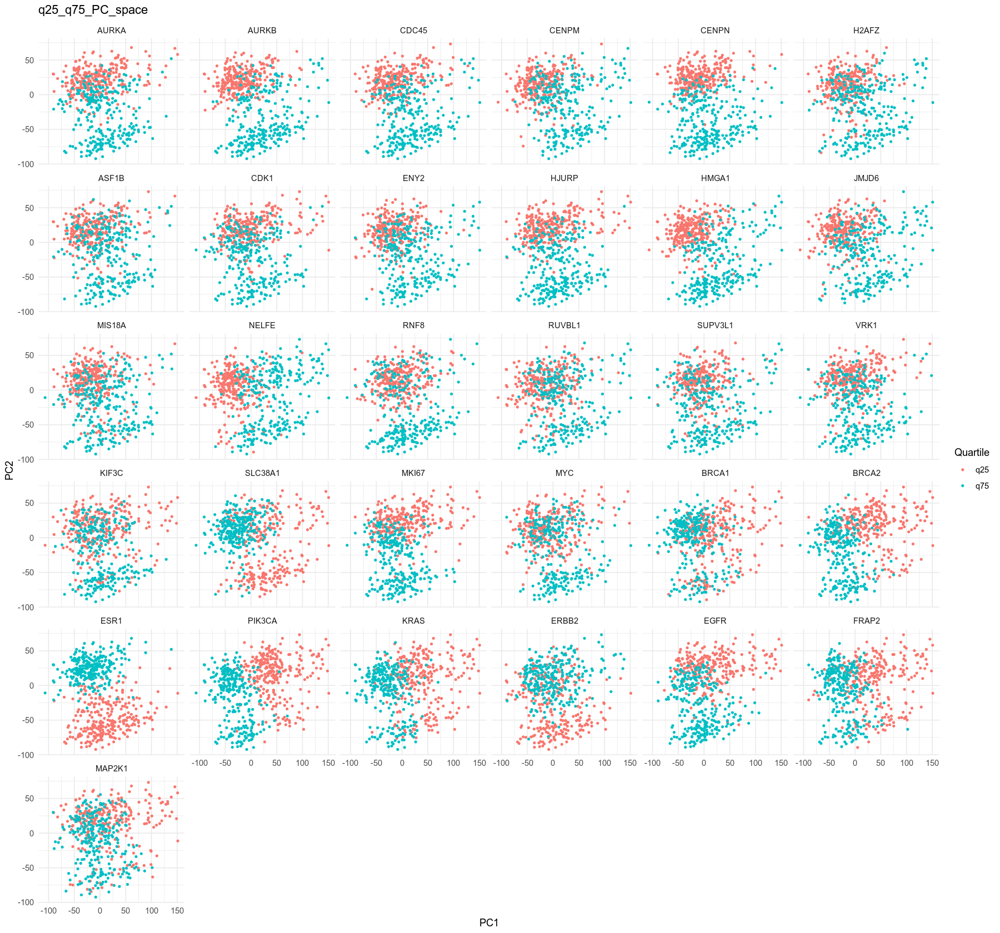

In [8]:
## extract CO and random gene indentity
gene_ident <- unlist(lapply(groupings, '[[', 2))
gene_ident[gene_ident == 'N'] <- 'CO'
gene_ident[gene_ident == 'Y'] <- 'Random'


## select out best hits and graph the q25 and q75 alone via color
## also graph a random grouping as control
## selected random gene = KIF3C
### genes to showcase = AURKA, AURKB, CDC45, CENPM, CENPN, H2AFZ
genes_to_graph = c('AURKA', 'AURKB', 'CDC45', 'CENPM', 'CENPN', 'H2AFZ', 'ASF1B', 'CDK1', 'ENY2', 'HJURP', 'HMGA1', 'JMJD6', 'MIS18A', 'NELFE', 'RNF8', 'RUVBL1', 'SUPV3L1', 'VRK1', 'KIF3C', 'SLC38A1', 'MKI67', 'MYC', 'BRCA1', 'BRCA2', 'ESR1', 'PIK3CA', 'KRAS', 'ERBB2', 'EGFR', 'FRAP2', 'MAP2K1')
## q25 vs q75 graphs in PCA space
names(grouped_dataframes_list_PCA_q25_q75_top2000DEGs) <- cluster_distances_PCA_2000DEGs_q25_q75$COs
lowers <- lapply(grouped_dataframes_list_PCA_q25_q75_top2000DEGs, '[[', 3)
uppers <- lapply(grouped_dataframes_list_PCA_q25_q75_top2000DEGs, '[[', 4)
lowers_select <- lowers[genes_to_graph]
uppers_select <- uppers[genes_to_graph]
lowers_select <- lapply(lowers_select, t)
uppers_select <- lapply(uppers_select, t)
lowers_select <- lapply(lowers_select, as.data.frame)
uppers_select <- lapply(uppers_select, as.data.frame)
lowers_select <- lapply(lowers_select, select, PC1, PC2)
uppers_select <- lapply(uppers_select, select, PC1, PC2)
lowers_select <- lapply(lowers_select, mutate, Quartile = 'q25')
uppers_select <- lapply(uppers_select, mutate, Quartile = 'q75')
combined <- mapply(rbind, lowers_select, uppers_select, SIMPLIFY = FALSE)
q25_q75_PCA_df <- bind_rows(combined, .id = 'Grouping_gene')
q25_q75_PCA_df$Grouping_gene = factor(q25_q75_PCA_df$Grouping_gene, levels = genes_to_graph)

options(repr.plot.width=15, repr.plot.height=14)
ggplot(q25_q75_PCA_df, aes(PC1, PC2, color = Quartile)) + geom_point(alpha = 1, size = 0.8) + facet_wrap(~Grouping_gene) + theme_minimal() +
  ggtitle('q25_q75_PC_space')

In [9]:
set.seed(22)
sampled_random_genes = sample(names(gene_ident[gene_ident == 'Random']), 30)
sampled_random_genes

[1] "LOC100506461" "CDH5"         "PIGA"         "CEP97"        "PTP4A3"      
 [6] "TWF1"         "HRASLS5"      "SRPK2"        "PGAR"         "GRL"         
[11] "CD3EAP"       "RCOR2"        "ADORA2B"      "POGZ"         "MTMR10"      
[16] "ARHGEF5"      "RNASEH1"      "RHOBTB2"      "ZFYVE21"      "MDK"         
[21] "RNF135"       "FUOM"         "SLC38A1"      "ZG16B"        "PDE3B"       
[26] "PLEKHH1"      "EN1"          "MRPS18C"      "TIGIT"        "ZNF551"

In [10]:
genes_to_graph2 = c('AURKA', 'AURKB', 'CDC45', 'CENPM', 'CENPN', 'H2AFZ', 'ASF1B', 'CDK1', 'ENY2', 'HJURP', 'HMGA1', 'JMJD6', 'MIS18A', 'NELFE', 'RNF8', 'RUVBL1', 'SUPV3L1', 'VRK1', 'HMGB3', 'RCCD1', 'EZH2', 'PRMT1', 'NUDT5', 'MRGBP', 'CCNA2')
genes_to_graph2 = genes_to_graph2[order(genes_to_graph2)]

In [11]:
### getting log(q75/q25 distance ratios) of 2000 DEGs > 10 FPKM PC distances ###
cluster_distances_PCA_2000DEGs_q25_q75[c(genes_to_graph2, sampled_random_genes),] -> PC_distances_select
PC_distances_select <- pivot_longer(PC_distances_select, names_to = 'Pctile', values_to = 'distance', cols = ends_with('pctile'))
PC_distances_select$Pctile = factor(PC_distances_select$Pctile, levels = c('lower_pctile', 'higher_pctile'))
PC_distances_select$COs = factor(PC_distances_select$COs, levels = c(genes_to_graph2, sampled_random_genes))
PC_distances_select = PC_distances_select %>% select(COs, high_to_low_ratio) %>% distinct(COs, high_to_low_ratio, .keep_all = TRUE)
PC_distances_select$identity = c(rep('CO', 25), rep('Random', 30))

In [12]:
pvals = lapply(distances_final_q25_q75_PCA_top2000DEGs, function(x) {
  t.test(x[[1]], x[[2]], paired = FALSE, alternative = 'two.sided')$p.value
})

pvals = p.adjust(unlist(pvals))

In [13]:
pvals = signif(pvals[c(genes_to_graph2, sampled_random_genes)],3)

In [14]:
PC_distances_select_final = PC_distances_select
PC_distances_select_final$pvals = pvals
PC_distances_select_final$high_to_low_ratio = log2(PC_distances_select_final$high_to_low_ratio)

In [15]:
PC_distances_select_final2 = PC_distances_select_final
PC_distances_select_final2$pvals = -log10(PC_distances_select_final2$pvals)

In [16]:
PC_distances_select_final3 = PC_distances_select_final2 %>% filter(COs %in% setdiff(COs,c('CDH5', 'SLC38A1', 'LOC100506461', 'TWF1', 'SRPK2')))

Warning message:
“ggrepel: 2 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


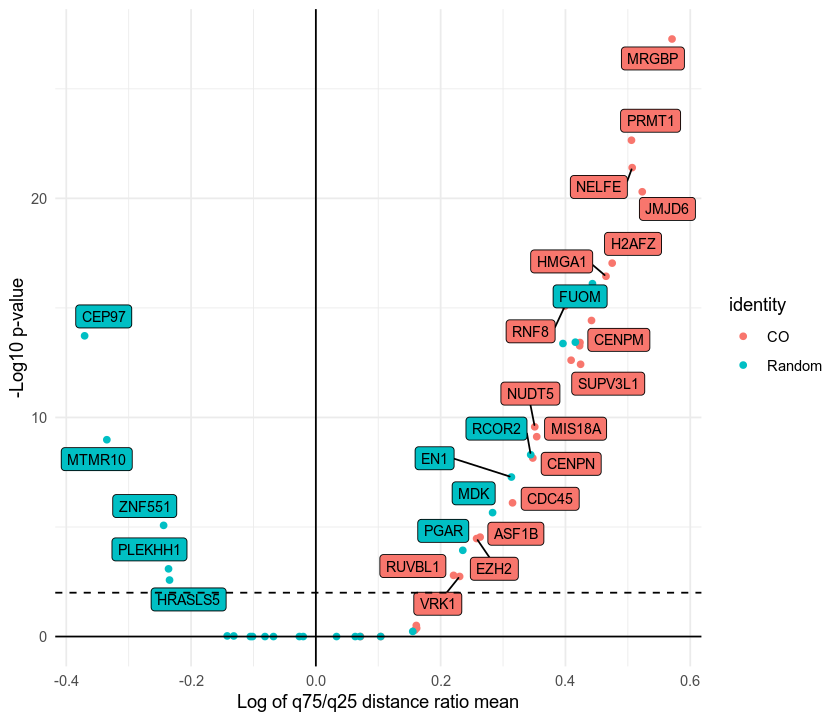

In [17]:
## this only uses genes > 10 FPKM for distance ratios, try PCA for all genes since Brian's original analysis uses all genes
options(repr.plot.width = 7, repr.plot.height = 6)
ggplot(PC_distances_select_final3, aes(high_to_low_ratio, pvals, fill = identity)) + geom_point(aes(color = identity)) + geom_label_repel(data = subset(PC_distances_select_final3, pvals > 2), aes(label = COs), size = 3, show.legend = FALSE) + theme_minimal() + geom_hline(yintercept = 2, linetype = 'dashed') + geom_vline(xintercept = 0) + geom_hline(yintercept = 0) + xlab('Log of q75/q25 distance ratio mean') + ylab('-Log10 p-value')
#ggsave('~/projects/heterogeneity_brian/notebooks/TCGA_breast_analysis/q25_q75_PCA_2000DEGs.pdf', width = 7, height = 6)

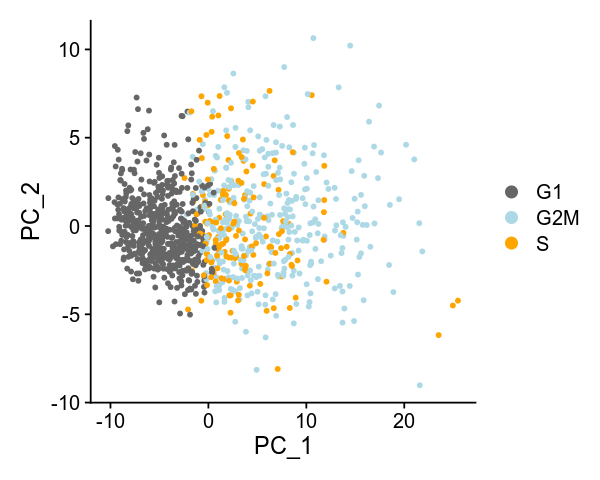

In [18]:
options(repr.plot.width=5, repr.plot.height=4)
DimPlot(rna_seq_seurat, cols = colors)

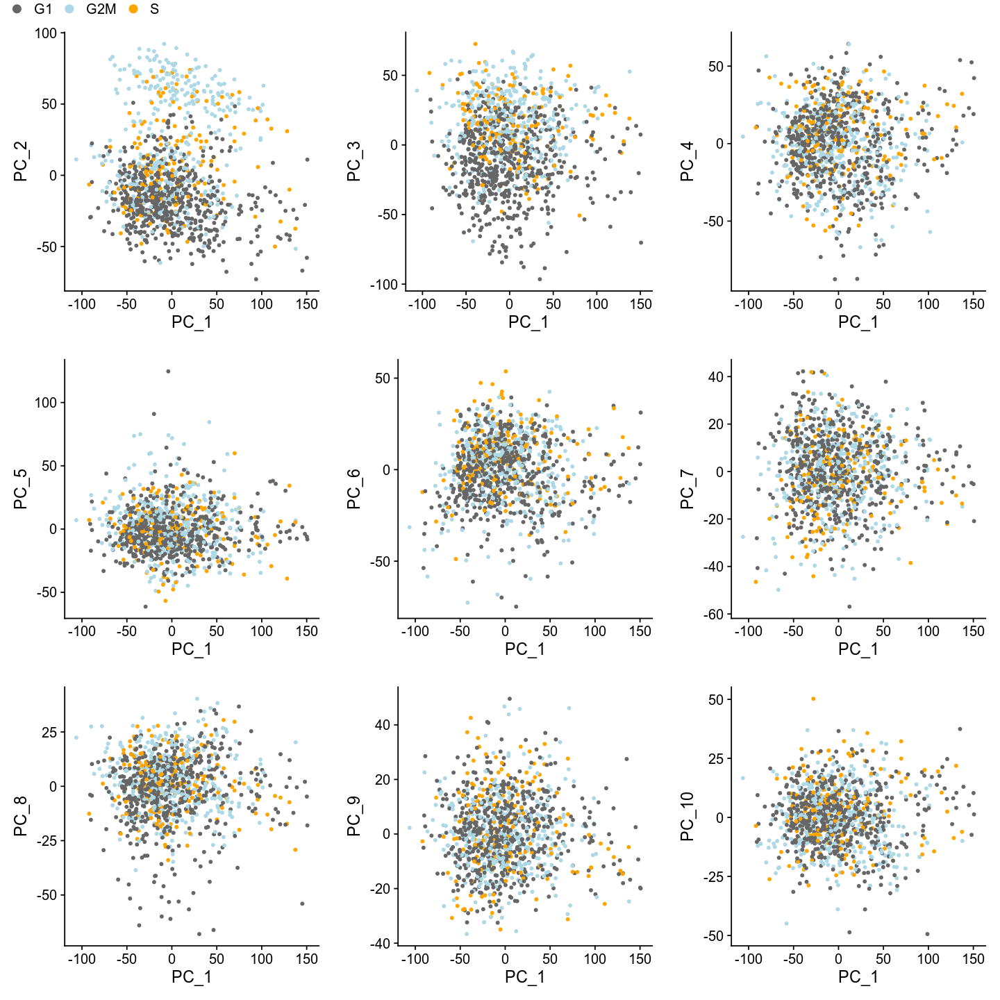

In [19]:
rna_seq_seurat <- RunPCA(rna_seq_seurat, features = rownames(rna_seq_seurat), verbose = FALSE)
options(repr.plot.width=12, repr.plot.height=12)
ggarrange(DimPlot(rna_seq_seurat, cols = colors), DimPlot(rna_seq_seurat, cols = colors, dims = c(1,3)), DimPlot(rna_seq_seurat, cols = colors, dims = c(1,4)),
DimPlot(rna_seq_seurat, cols = colors, dims = c(1,5)), DimPlot(rna_seq_seurat, cols = colors, dims = c(1,6)), DimPlot(rna_seq_seurat, cols = colors, dims = c(1,7)),
DimPlot(rna_seq_seurat, cols = colors, dims = c(1,8)), DimPlot(rna_seq_seurat, cols = colors, dims = c(1,9)), DimPlot(rna_seq_seurat, cols = colors, dims = c(1,10)), ncol = 3, nrow = 3, common.legend = TRUE)

Warning message:
“Non-unique features (rownames) present in the input matrix, making unique”
Warning message:
“Feature names cannot have underscores ('_'), replacing with dashes ('-')”
Warning message:
“The following features are not present in the object: TYMS, RRM1, UHRF1, HELLS, NASP, SLBP, ATAD2, CASP8AP2, POLA1, not searching for symbol synonyms”
Warning message:
“The following features are not present in the object: NUSAP1, TPX2, CKS1B, CENPF, PIMREG, CKAP2, BUB1, JPT1, RANGAP1, not searching for symbol synonyms”
Regressing out S.Score, G2M.Score

Centering and scaling data matrix

Warning message in irlba(A = t(x = object), nv = npcs, ...):
“You're computing too large a percentage of total singular values, use a standard svd instead.”


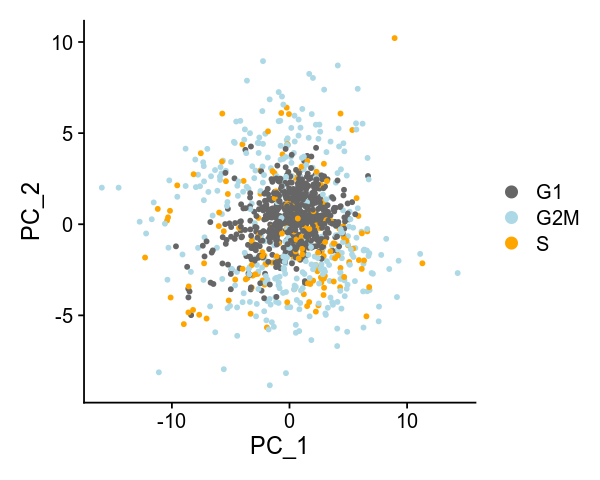

In [20]:
rna_seq_seurat_regressed_cc <- CreateSeuratObject(counts = raw_counts)
rna_seq_seurat_regressed_cc <- NormalizeData(rna_seq_seurat_regressed_cc)
rna_seq_seurat_regressed_cc <- CellCycleScoring(rna_seq_seurat_regressed_cc, s.features = s.genes, g2m.features = g2m.genes, set.ident = TRUE)
rna_seq_seurat_regressed_cc <- ScaleData(rna_seq_seurat_regressed_cc, vars.to.regress = c("S.Score", "G2M.Score"), features = rownames(rna_seq_seurat_regressed_cc))
rna_seq_seurat_regressed_cc <- RunPCA(rna_seq_seurat_regressed_cc, features = c(s.genes, g2m.genes), verbose = FALSE)
options(repr.plot.width=5, repr.plot.height=4)
DimPlot(rna_seq_seurat_regressed_cc, cols = colors)

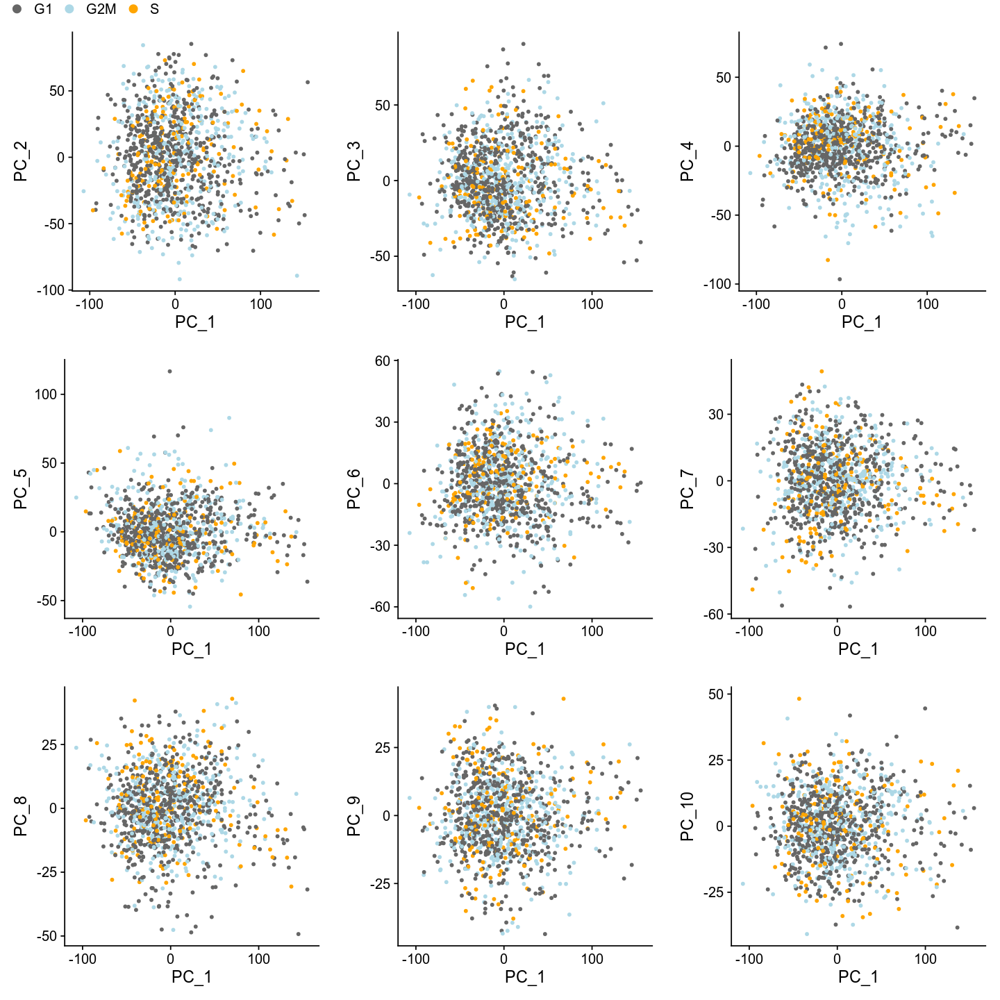

In [21]:
rna_seq_seurat_regressed_cc <- RunPCA(rna_seq_seurat_regressed_cc, features = rownames(rna_seq_seurat_regressed_cc), verbose = FALSE)
options(repr.plot.width=12, repr.plot.height=12)
ggarrange(DimPlot(rna_seq_seurat_regressed_cc, cols = colors), DimPlot(rna_seq_seurat_regressed_cc, cols = colors, dims = c(1,3)), DimPlot(rna_seq_seurat_regressed_cc, cols = colors, dims = c(1,4)),
DimPlot(rna_seq_seurat_regressed_cc, cols = colors, dims = c(1,5)), DimPlot(rna_seq_seurat_regressed_cc, cols = colors, dims = c(1,6)), DimPlot(rna_seq_seurat_regressed_cc, cols = colors, dims = c(1,7)),
DimPlot(rna_seq_seurat_regressed_cc, cols = colors, dims = c(1,8)), DimPlot(rna_seq_seurat_regressed_cc, cols = colors, dims = c(1,9)), DimPlot(rna_seq_seurat_regressed_cc, cols = colors, dims = c(1,10)), ncol = 3, nrow = 3, common.legend = TRUE)

Warning message:
“Non-unique features (rownames) present in the input matrix, making unique”
Warning message:
“Feature names cannot have underscores ('_'), replacing with dashes ('-')”
Warning message:
“The following features are not present in the object: TYMS, RRM1, UHRF1, HELLS, NASP, SLBP, ATAD2, CASP8AP2, POLA1, not searching for symbol synonyms”
Warning message:
“The following features are not present in the object: NUSAP1, TPX2, CKS1B, CENPF, PIMREG, CKAP2, BUB1, JPT1, RANGAP1, not searching for symbol synonyms”
Regressing out CC.Difference

Centering and scaling data matrix

Warning message in irlba(A = t(x = object), nv = npcs, ...):
“You're computing too large a percentage of total singular values, use a standard svd instead.”


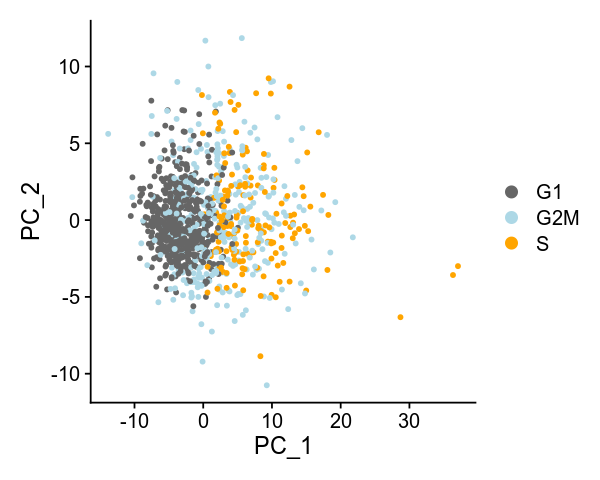

In [22]:
rna_seq_seurat_regressed_cc_G2M_S_diff <- CreateSeuratObject(counts = raw_counts)
rna_seq_seurat_regressed_cc_G2M_S_diff <- NormalizeData(rna_seq_seurat_regressed_cc_G2M_S_diff)
rna_seq_seurat_regressed_cc_G2M_S_diff <- CellCycleScoring(rna_seq_seurat_regressed_cc_G2M_S_diff, s.features = s.genes, g2m.features = g2m.genes, set.ident = TRUE)
rna_seq_seurat_regressed_cc_G2M_S_diff$CC.Difference <- rna_seq_seurat_regressed_cc_G2M_S_diff$S.Score - rna_seq_seurat_regressed_cc_G2M_S_diff$G2M.Score
rna_seq_seurat_regressed_cc_G2M_S_diff <- ScaleData(rna_seq_seurat_regressed_cc_G2M_S_diff, vars.to.regress = "CC.Difference", features = rownames(rna_seq_seurat_regressed_cc_G2M_S_diff))
rna_seq_seurat_regressed_cc_G2M_S_diff <- RunPCA(rna_seq_seurat_regressed_cc_G2M_S_diff, features = c(s.genes, g2m.genes), verbose = FALSE)
options(repr.plot.width=5, repr.plot.height=4)
DimPlot(rna_seq_seurat_regressed_cc_G2M_S_diff, cols = colors)

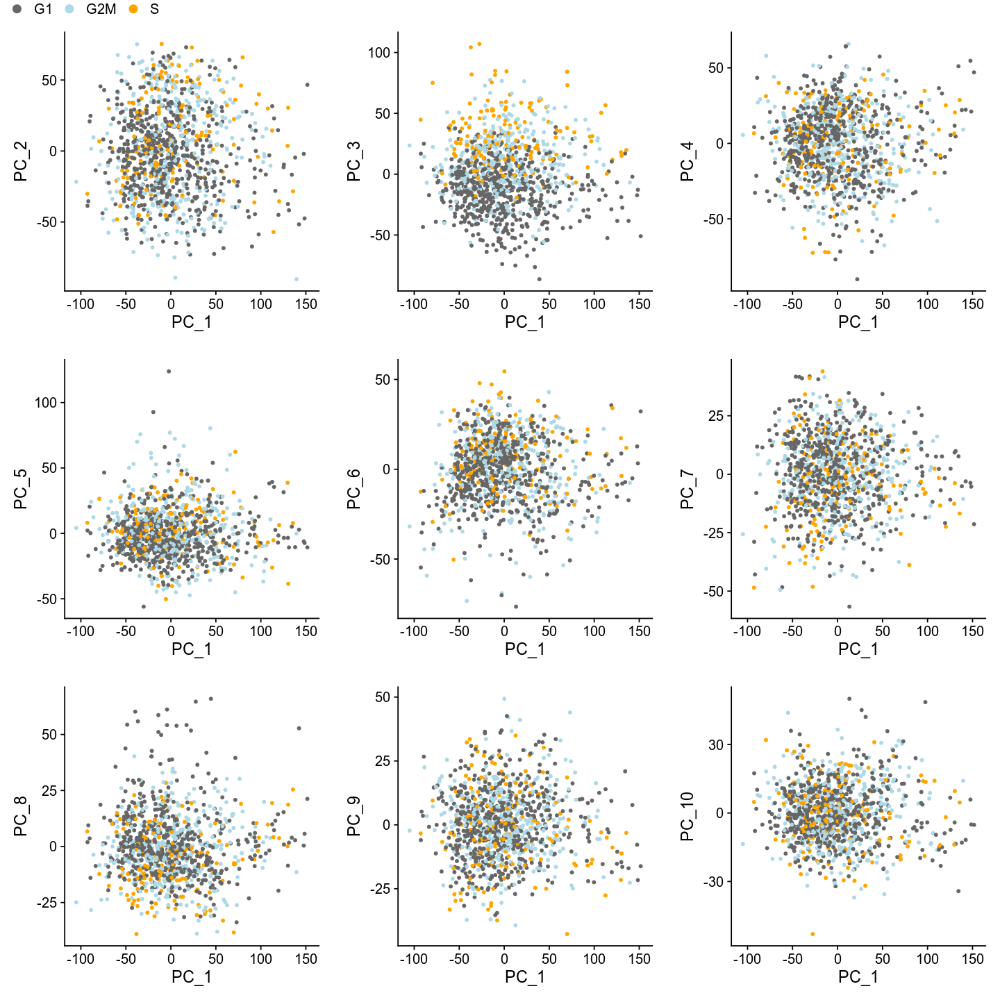

In [23]:
rna_seq_seurat_regressed_cc_G2M_S_diff <- RunPCA(rna_seq_seurat_regressed_cc_G2M_S_diff, features = rownames(rna_seq_seurat_regressed_cc_G2M_S_diff), verbose = FALSE)
options(repr.plot.width=12, repr.plot.height=12)
ggarrange(DimPlot(rna_seq_seurat_regressed_cc_G2M_S_diff, cols = colors), DimPlot(rna_seq_seurat_regressed_cc_G2M_S_diff, cols = colors, dims = c(1,3)), DimPlot(rna_seq_seurat_regressed_cc_G2M_S_diff, cols = colors, dims = c(1,4)),
DimPlot(rna_seq_seurat_regressed_cc_G2M_S_diff, cols = colors, dims = c(1,5)), DimPlot(rna_seq_seurat_regressed_cc_G2M_S_diff, cols = colors, dims = c(1,6)), DimPlot(rna_seq_seurat_regressed_cc_G2M_S_diff, cols = colors, dims = c(1,7)),
DimPlot(rna_seq_seurat_regressed_cc_G2M_S_diff, cols = colors, dims = c(1,8)), DimPlot(rna_seq_seurat_regressed_cc_G2M_S_diff, cols = colors, dims = c(1,9)), DimPlot(rna_seq_seurat_regressed_cc_G2M_S_diff, cols = colors, dims = c(1,10)), ncol = 3, nrow = 3, common.legend = TRUE)

## Analysis (cell cycle NOT regressed) ##

In [24]:
### This cell runs the PCA analysis on only the top 2000 DEGs (> 10 FPKM) ###
#### edited out non-DEG genes here ####
head(VariableFeatures(rna_seq_seurat), 2000) -> var.genes
var.genes.idx <- match(var.genes, row.names(rna_seq_seurat@assays$RNA))
raw_counts_2000DEGs <- rna_seq_seurat@assays$RNA@scale.data[var.genes.idx,]

### note for PCA here we are using the SVD algorithm
# The algorithm returns the same number of PCs as there are observations
## This is because SVD does not use the covariance matrix to compute PCs
rownames(raw_counts_2000DEGs) <- row.names(rna_seq_seurat@assays$RNA)[var.genes.idx]
pca1 = prcomp(t(raw_counts_2000DEGs), scale. = TRUE)
PCA_coordinates = pca1$x
PCA_coordinates_final = PCA_coordinates[, 1:50]
PCA_coordinates_final = t(PCA_coordinates_final)
PCA_coordinates_final -> PCA_coordinates_final_q25_q75_top2000DEGs
eigs <- pca1$sdev^2
eigen_values = eigs
explained_variance = eigs/sum(eigs)
explained_variance = explained_variance[1:50]


dataframe_returner <- function (key, full_data, additional_col_vectors = c(),
                                key_gene_entry = 1, key_random_entry = 2, 
                                key_25_entry = 3, key_75_entry = 4) {
  #additional_col_vectors fetches columns by name
  
  #Idea is to aggr. the columns that correspond to the 'correct' patients for each
  #quartile grouping
  q25_dataframe = full_data[, colnames(full_data) %in% c(additional_col_vectors,
                                                         key[[key_25_entry]])]
  #key_2/75_entry is a numeric index
  q75_dataframe = full_data[, colnames(full_data) %in% c(additional_col_vectors,
                                                         key[[key_75_entry]])]
  return (list(key[[key_gene_entry]], key[[key_random_entry]],
               q25_dataframe, q75_dataframe))
}

grouped_dataframes_list <- lapply(groupings, dataframe_returner, 
                                  PCA_coordinates_final)

grouped_dataframes_list_PCA_q25_q75_top2000DEGs <- grouped_dataframes_list
## groupings 494 - 543 are groupings based on random genes ##

transposer <- function(x){
  lower_pct = t(x[[3]])
  upper_pct = t(x[[4]])
  return(list(lower_pct, upper_pct))
}

grouped_dataframes_list_dist_prepped <- pblapply(grouped_dataframes_list, transposer)

library(parallelDist)

#find euclidean mean vector for cells per each drug treatment
centroid_appender <- function(x){
  lower_pct = rbind(colMeans(x[[1]]), x[[1]])
  upper_pct = rbind(colMeans(x[[2]]), x[[2]])
  return(list(lower_pct, upper_pct))
}

grouped_dataframes_list_dist_prepped2 <- pblapply(grouped_dataframes_list_dist_prepped, centroid_appender)

weighted_distance_calculator = function(x, weights) {
  dist1 = apply(x[[1]][-1,], 1, function(z, centroid) {sqrt(sum(weights*(z - centroid)^2))}, x[[1]][1,])
  dist2 = apply(x[[2]][-1,], 1, function(z, centroid) {sqrt(sum(weights*(z - centroid)^2))}, x[[2]][1,])
  return(list(dist1, dist2))
}

distances_final <- pblapply(grouped_dataframes_list_dist_prepped2, weighted_distance_calculator, explained_variance)
distances_final -> distances_final_q25_q75_PCA_top2000DEGs

mean_distance_calculator <- function(x){
  return(c(mean(as.numeric(x[[1]])), mean(as.numeric(x[[2]]))))
}

cluster_distances <- pblapply(distances_final, mean_distance_calculator)
cluster_distances <- do.call(rbind, cluster_distances)
cluster_distances <- as.data.frame(cluster_distances)
colnames(cluster_distances) <- c('lower_pctile', 'higher_pctile')
cluster_distances$high_to_low_ratio = cluster_distances$higher_pctile/cluster_distances$lower_pctile

cluster_distances <- cbind(COs = rownames(cluster_distances), cluster_distances)
cluster_distances -> cluster_distances_PCA_2000DEGs_q25_q75
#save(distances_final_q25_q75_PCA_top2000DEGs, PCA_coordinates_final_q25_q75_top2000DEGs, grouped_dataframes_list_PCA_q25_q75_top2000DEGs, cluster_distances_PCA_2000DEGs_q25_q75, file = '/home/ssobti/projects/heterogeneity_brian/output_data/distance_analysis/sample_distances_q25_q75_PCA_2000DEGs.RData')


In [25]:
### This cell runs the PCA analysis on all genes > 10 FPKM ###
#### edited out non-DEG genes here ####

raw_counts_all_genes <- rna_seq_seurat@assays$RNA@scale.data

### note for PCA here we are using the SVD algorithm
# The algorithm returns the same number of PCs as there are observations
## This is because SVD does not use the covariance matrix to compute PCs
rownames(raw_counts_all_genes) <- row.names(rna_seq_seurat@assays$RNA)
pca1 = prcomp(t(raw_counts_all_genes), scale. = TRUE)
PCA_coordinates = pca1$x
PCA_coordinates_final = PCA_coordinates[, 1:50]
PCA_coordinates_final = t(PCA_coordinates_final)
PCA_coordinates_final -> PCA_coordinates_final_q25_q75_all_genes
eigs <- pca1$sdev^2
eigen_values = eigs
explained_variance = eigs/sum(eigs)
explained_variance = explained_variance[1:50]

dataframe_returner <- function (key, full_data, additional_col_vectors = c(),
                                key_gene_entry = 1, key_random_entry = 2, 
                                key_25_entry = 3, key_75_entry = 4) {
  #additional_col_vectors fetches columns by name
  
  #Idea is to aggr. the columns that correspond to the 'correct' patients for each
  #quartile grouping
  q25_dataframe = full_data[, colnames(full_data) %in% c(additional_col_vectors,
                                                         key[[key_25_entry]])]
  #key_2/75_entry is a numeric index
  q75_dataframe = full_data[, colnames(full_data) %in% c(additional_col_vectors,
                                                         key[[key_75_entry]])]
  return (list(key[[key_gene_entry]], key[[key_random_entry]],
               q25_dataframe, q75_dataframe))
}

grouped_dataframes_list <- lapply(groupings, dataframe_returner, 
                                  PCA_coordinates_final)

grouped_dataframes_list_PCA_q25_q75_all_genes <- grouped_dataframes_list
## groupings 494 - 543 are groupings based on random genes ##

transposer <- function(x){
  lower_pct = t(x[[3]])
  upper_pct = t(x[[4]])
  return(list(lower_pct, upper_pct))
}

grouped_dataframes_list_dist_prepped <- pblapply(grouped_dataframes_list, transposer)

library(parallelDist)

#find euclidean mean vector for cells per each drug treatment
centroid_appender <- function(x){
  lower_pct = rbind(colMeans(x[[1]]), x[[1]])
  upper_pct = rbind(colMeans(x[[2]]), x[[2]])
  return(list(lower_pct, upper_pct))
}

grouped_dataframes_list_dist_prepped2 <- pblapply(grouped_dataframes_list_dist_prepped, centroid_appender)

weighted_distance_calculator = function(x, weights) {
  dist1 = apply(x[[1]][-1,], 1, function(z, centroid) {sqrt(sum(weights*(z - centroid)^2))}, x[[1]][1,])
  dist2 = apply(x[[2]][-1,], 1, function(z, centroid) {sqrt(sum(weights*(z - centroid)^2))}, x[[2]][1,])
  return(list(dist1, dist2))
}

distances_final <- pblapply(grouped_dataframes_list_dist_prepped2, weighted_distance_calculator, explained_variance)
distances_final -> distances_final_q25_q75_PCA_all_genes

mean_distance_calculator <- function(x){
  return(c(mean(as.numeric(x[[1]])), mean(as.numeric(x[[2]]))))
}

cluster_distances <- pblapply(distances_final, mean_distance_calculator)
cluster_distances <- do.call(rbind, cluster_distances)
cluster_distances <- as.data.frame(cluster_distances)
colnames(cluster_distances) <- c('lower_pctile', 'higher_pctile')
cluster_distances$high_to_low_ratio = cluster_distances$higher_pctile/cluster_distances$lower_pctile

cluster_distances <- cbind(COs = rownames(cluster_distances), cluster_distances)
cluster_distances -> cluster_distances_PCA_all_genes_q25_q75
#save(distances_final_q25_q75_PCA_all_genes, PCA_coordinates_final_q25_q75_all_genes, grouped_dataframes_list_PCA_q25_q75_all_genes, cluster_distances_PCA_all_genes_q25_q75, file = '/home/ssobti/projects/heterogeneity_brian/output_data/distance_analysis/sample_distances_q25_q75_PCA_2000DEGs.RData')

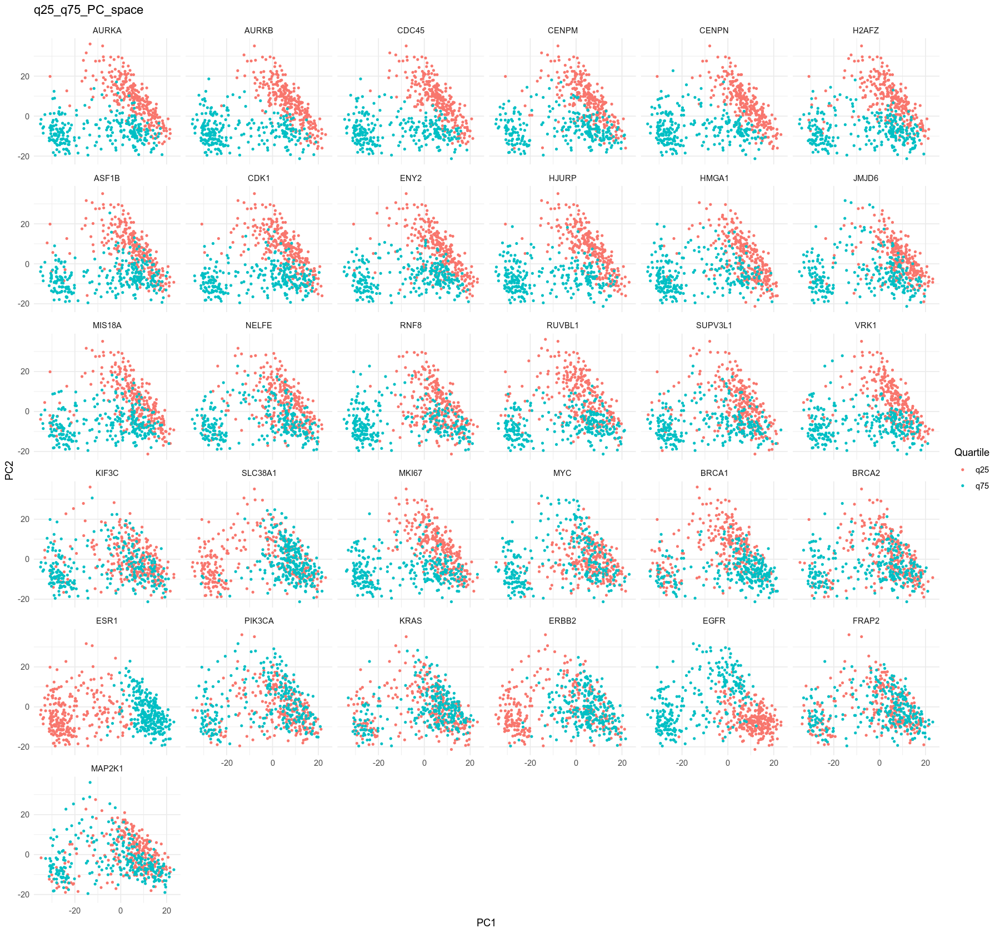

In [26]:
## extract CO and random gene indentity
gene_ident <- unlist(lapply(groupings, '[[', 2))
gene_ident[gene_ident == 'N'] <- 'CO'
gene_ident[gene_ident == 'Y'] <- 'Random'


## select out best hits and graph the q25 and q75 alone via color
## also graph a random grouping as control
## selected random gene = KIF3C
### genes to showcase = AURKA, AURKB, CDC45, CENPM, CENPN, H2AFZ
genes_to_graph = c('AURKA', 'AURKB', 'CDC45', 'CENPM', 'CENPN', 'H2AFZ', 'ASF1B', 'CDK1', 'ENY2', 'HJURP', 'HMGA1', 'JMJD6', 'MIS18A', 'NELFE', 'RNF8', 'RUVBL1', 'SUPV3L1', 'VRK1', 'KIF3C', 'SLC38A1', 'MKI67', 'MYC', 'BRCA1', 'BRCA2', 'ESR1', 'PIK3CA', 'KRAS', 'ERBB2', 'EGFR', 'FRAP2', 'MAP2K1')
## q25 vs q75 graphs in PCA space
names(grouped_dataframes_list_PCA_q25_q75_top2000DEGs) <- cluster_distances_PCA_2000DEGs_q25_q75$COs
lowers <- lapply(grouped_dataframes_list_PCA_q25_q75_top2000DEGs, '[[', 3)
uppers <- lapply(grouped_dataframes_list_PCA_q25_q75_top2000DEGs, '[[', 4)
lowers_select <- lowers[genes_to_graph]
uppers_select <- uppers[genes_to_graph]
lowers_select <- lapply(lowers_select, t)
uppers_select <- lapply(uppers_select, t)
lowers_select <- lapply(lowers_select, as.data.frame)
uppers_select <- lapply(uppers_select, as.data.frame)
lowers_select <- lapply(lowers_select, select, PC1, PC2)
uppers_select <- lapply(uppers_select, select, PC1, PC2)
lowers_select <- lapply(lowers_select, mutate, Quartile = 'q25')
uppers_select <- lapply(uppers_select, mutate, Quartile = 'q75')
combined <- mapply(rbind, lowers_select, uppers_select, SIMPLIFY = FALSE)
q25_q75_PCA_df <- bind_rows(combined, .id = 'Grouping_gene')
q25_q75_PCA_df$Grouping_gene = factor(q25_q75_PCA_df$Grouping_gene, levels = genes_to_graph)

options(repr.plot.width=15, repr.plot.height=14)
ggplot(q25_q75_PCA_df, aes(PC1, PC2, color = Quartile)) + geom_point(alpha = 1, size = 0.8) + facet_wrap(~Grouping_gene) + theme_minimal() +
  ggtitle('q25_q75_PC_space')

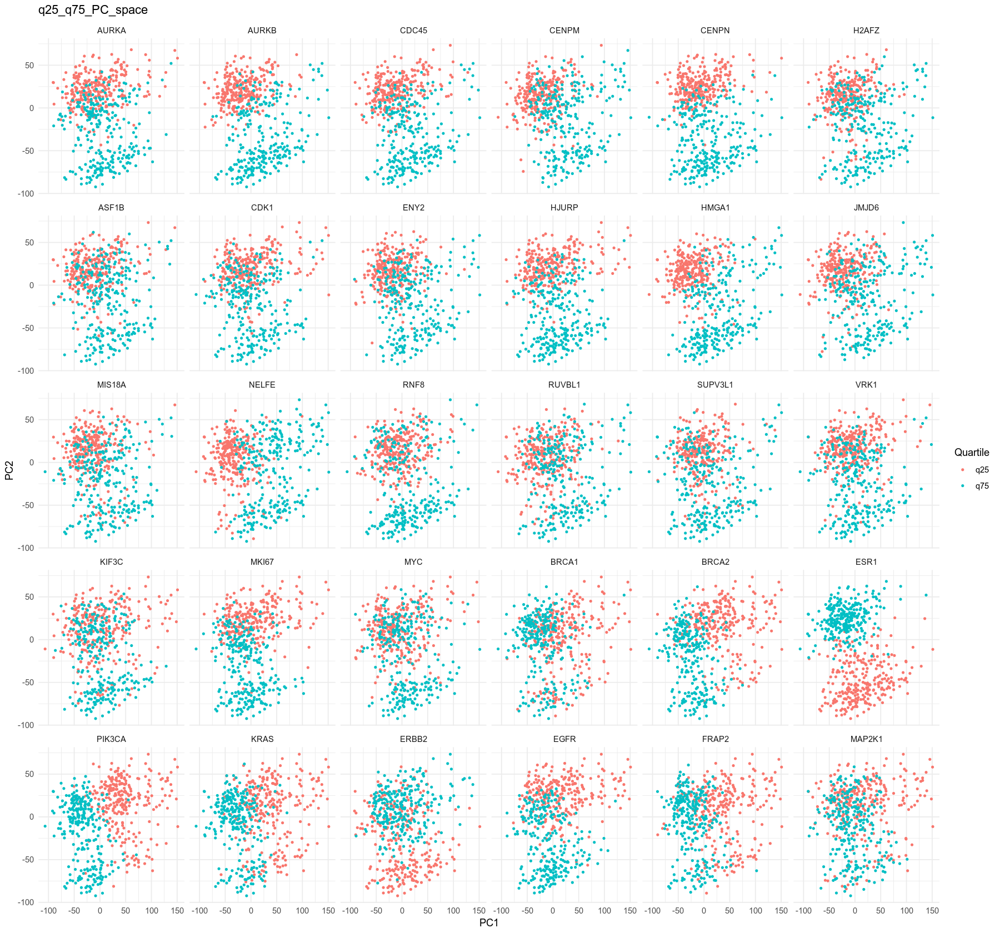

In [27]:
## extract CO and random gene indentity
gene_ident <- unlist(lapply(groupings, '[[', 2))
gene_ident[gene_ident == 'N'] <- 'CO'
gene_ident[gene_ident == 'Y'] <- 'Random'


## select out best hits and graph the q25 and q75 alone via color
## also graph a random grouping as control
## selected random gene = KIF3C
### genes to showcase = AURKA, AURKB, CDC45, CENPM, CENPN, H2AFZ
genes_to_graph = c('AURKA', 'AURKB', 'CDC45', 'CENPM', 'CENPN', 'H2AFZ', 'ASF1B', 'CDK1', 'ENY2', 'HJURP', 'HMGA1', 'JMJD6', 'MIS18A', 'NELFE', 'RNF8', 'RUVBL1', 'SUPV3L1', 'VRK1', 'KIF3C', 'MKI67', 'MYC', 'BRCA1', 'BRCA2', 'ESR1', 'PIK3CA', 'KRAS', 'ERBB2', 'EGFR', 'FRAP2', 'MAP2K1')

## q25 vs q75 graphs in PCA space
names(grouped_dataframes_list_PCA_q25_q75_all_genes) <- cluster_distances_PCA_all_genes_q25_q75$COs
lowers <- lapply(grouped_dataframes_list_PCA_q25_q75_all_genes, '[[', 3)
uppers <- lapply(grouped_dataframes_list_PCA_q25_q75_all_genes, '[[', 4)
lowers_select <- lowers[genes_to_graph]
uppers_select <- uppers[genes_to_graph]
lowers_select <- lapply(lowers_select, t)
uppers_select <- lapply(uppers_select, t)
lowers_select <- lapply(lowers_select, as.data.frame)
uppers_select <- lapply(uppers_select, as.data.frame)
lowers_select <- lapply(lowers_select, select, PC1, PC2)
uppers_select <- lapply(uppers_select, select, PC1, PC2)
lowers_select <- lapply(lowers_select, mutate, Quartile = 'q25')
uppers_select <- lapply(uppers_select, mutate, Quartile = 'q75')
combined <- mapply(rbind, lowers_select, uppers_select, SIMPLIFY = FALSE)
q25_q75_PCA_df <- bind_rows(combined, .id = 'Grouping_gene')
q25_q75_PCA_df$Grouping_gene = factor(q25_q75_PCA_df$Grouping_gene, levels = genes_to_graph)

ggplot(q25_q75_PCA_df, aes(PC1, PC2, color = Quartile)) + geom_point(alpha = 1, size = 0.8) + facet_wrap(~Grouping_gene) + theme_minimal() +
  ggtitle('q25_q75_PC_space')

In [28]:
set.seed(22)
sampled_random_genes = sample(names(gene_ident[gene_ident == 'Random']), 25)
sampled_random_genes

[1] "LOC100506461" "CDH5"         "PIGA"         "CEP97"        "PTP4A3"      
 [6] "TWF1"         "HRASLS5"      "SRPK2"        "PGAR"         "GRL"         
[11] "CD3EAP"       "RCOR2"        "ADORA2B"      "POGZ"         "MTMR10"      
[16] "ARHGEF5"      "RNASEH1"      "RHOBTB2"      "ZFYVE21"      "MDK"         
[21] "RNF135"       "FUOM"         "SLC38A1"      "ZG16B"        "PDE3B"

In [29]:
set.seed(54321)
sampled_random_genes = sample(names(gene_ident[gene_ident == 'Random']), 25)
sampled_random_genes

[1] "MRPS18C"      "PITPNC1"      "YIPF3"        "CEP97"        "TGFBR2"      
 [6] "ZFR"          "LOC100506461" "KIF3C"        "PIK3C2A"      "TMED7-TICAM2"
[11] "TWF1"         "SEMA4B"       "CDH5"         "PLEKHH1"      "PLEKHA6"     
[16] "RNF135"       "FUOM"         "CXorf3"       "ZFYVE21"      "OCRL"        
[21] "PGAR"         "MDK"          "PDE3B"        "MTMR10"       "ZG16B"

In [30]:
genes_to_graph2 = c('AURKA', 'AURKB', 'CDC45', 'CENPM', 'CENPN', 'H2AFZ', 'ASF1B', 'CDK1', 'ENY2', 'HJURP', 'HMGA1', 'JMJD6', 'MIS18A', 'NELFE', 'RNF8', 'RUVBL1', 'SUPV3L1', 'VRK1', 'HMGB3', 'RCCD1', 'EZH2', 'PRMT1', 'NUDT5', 'MRGBP', 'CCNA2')
genes_to_graph2 = genes_to_graph2[order(genes_to_graph2)]

In [31]:
### show barplot of 2000 DEGs > 10 FPKM PC distances ###
cluster_distances_PCA_2000DEGs_q25_q75[c(genes_to_graph2, sampled_random_genes),] -> PC_distances_select
PC_distances_select <- pivot_longer(PC_distances_select, names_to = 'Pctile', values_to = 'distance', cols = ends_with('pctile'))
PC_distances_select$Pctile = factor(PC_distances_select$Pctile, levels = c('lower_pctile', 'higher_pctile'))
PC_distances_select$COs = factor(PC_distances_select$COs, levels = c(genes_to_graph2, sampled_random_genes))
PC_distances_select = PC_distances_select %>% select(COs, high_to_low_ratio) %>% distinct(COs, high_to_low_ratio, .keep_all = TRUE)
PC_distances_select$identity = c(rep('CO', 25), rep('Random', 25))

In [32]:
pvals = lapply(distances_final_q25_q75_PCA_top2000DEGs, function(x) {
  t.test(x[[1]], x[[2]], paired = FALSE, alternative = 'two.sided')$p.value
})

pvals = p.adjust(unlist(pvals))

In [33]:
pvals = signif(pvals[c(genes_to_graph2, sampled_random_genes)],3)

In [34]:
PC_distances_select_final = PC_distances_select
PC_distances_select_final$pvals = pvals
PC_distances_select_final$high_to_low_ratio = log2(PC_distances_select_final$high_to_low_ratio)

In [35]:
PC_distances_select_final2 = PC_distances_select_final
PC_distances_select_final2$pvals = -log10(PC_distances_select_final2$pvals)

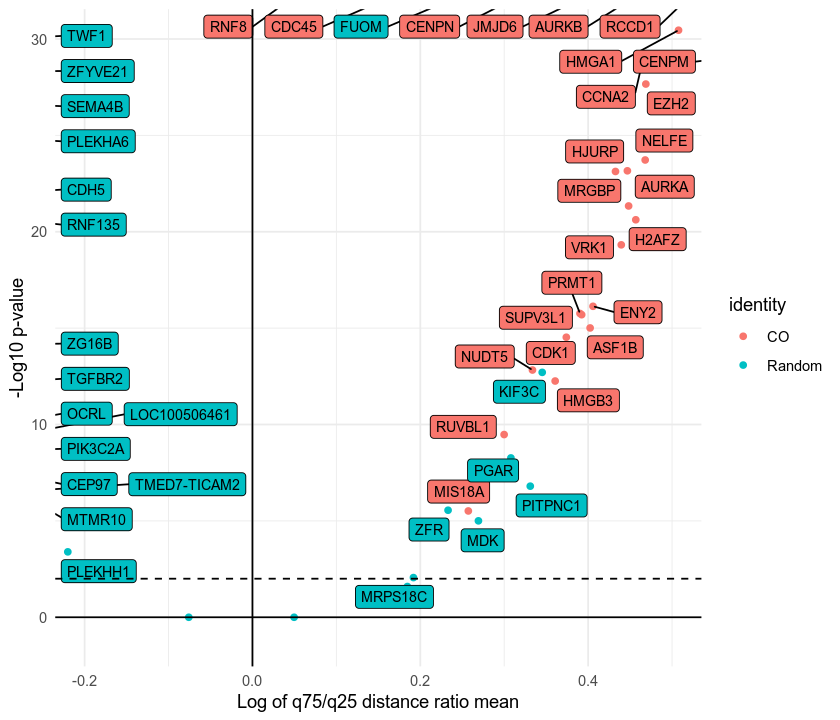

In [36]:
## this only uses genes > 10 FPKM for distance ratios, try PCA for all genes since Brian's original analysis uses all genes
options(repr.plot.width = 7, repr.plot.height = 6)
ggplot(PC_distances_select_final2, aes(high_to_low_ratio, pvals, fill = identity)) + geom_point(aes(color = identity)) + coord_cartesian(xlim = c(-0.2, 0.5), ylim = c(-1, 30)) + geom_label_repel(data = subset(PC_distances_select_final2, pvals > 2), aes(label = COs), size = 3, show.legend = FALSE) + theme_minimal() + geom_hline(yintercept = 2, linetype = 'dashed') + geom_vline(xintercept = 0) + geom_hline(yintercept = 0) + xlab('Log of q75/q25 distance ratio mean') + ylab('-Log10 p-value')
#ggsave('~/projects/heterogeneity_brian/notebooks/TCGA_breast_analysis/q25_q75_PCA_2000DEGs.pdf', width = 7, height = 6)

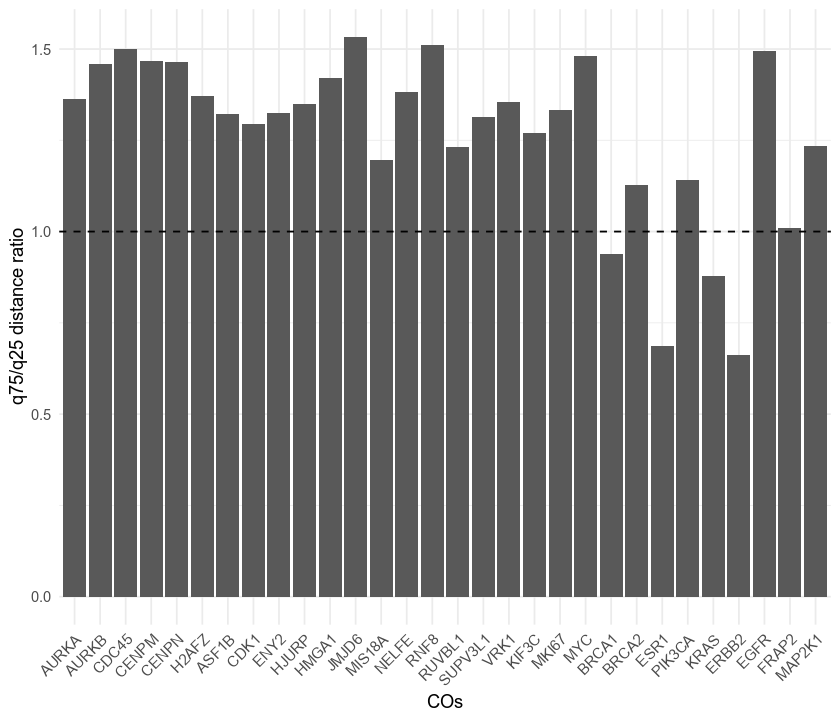

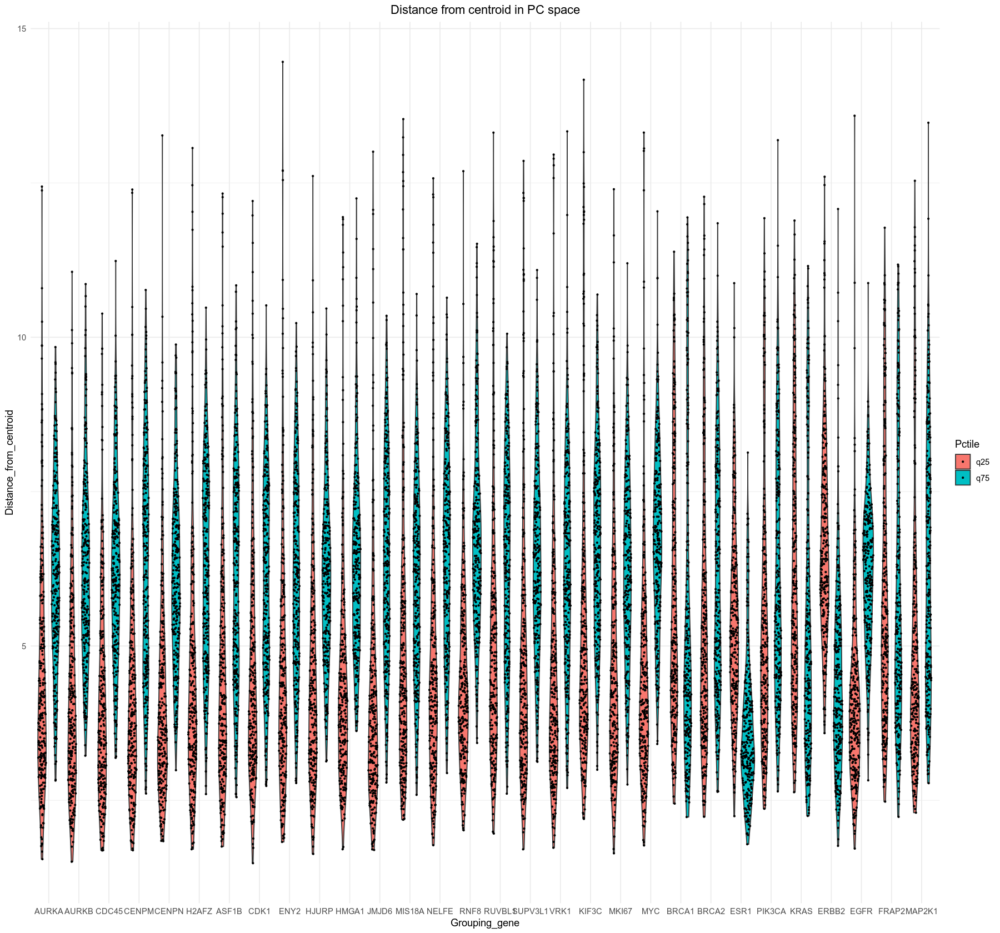

In [37]:
### show barplot of 2000 DEGs > 10 FPKM PC distances ###
cluster_distances_PCA_2000DEGs_q25_q75[genes_to_graph,] -> PC_distances_select

PC_distances_select <- pivot_longer(PC_distances_select, names_to = 'Pctile', values_to = 'distance', cols = ends_with('pctile'))
PC_distances_select$Pctile = factor(PC_distances_select$Pctile, levels = c('lower_pctile', 'higher_pctile'))
PC_distances_select$COs = factor(PC_distances_select$COs, levels = genes_to_graph)

PC_distances_select = PC_distances_select %>% select(COs, high_to_low_ratio) %>% distinct(COs, high_to_low_ratio, .keep_all = TRUE)
ggplot(PC_distances_select, aes(COs, high_to_low_ratio)) + ylab('q75/q25 distance ratio') +
  geom_bar(stat="identity", position=position_dodge()) + theme_minimal() + theme(axis.text.x = element_text(angle = 45, hjust = 1)) + geom_hline(yintercept = 1, linetype = 'dashed')

### show sina plot of distances for 6 genes + all Brian's hits
## later on recalculate the distance metric using say the top 5 PCs or so to get
## better separation in this sina plot
distances_final_q25_q75_PCA_top2000DEGs[genes_to_graph] -> selected_gene_distances
lowers_select <- lapply(selected_gene_distances, '[[', 1)
uppers_select <- lapply(selected_gene_distances, '[[', 2)
lapply(genes_to_graph, rep, length(lowers_select[[1]])) -> tmp
grps <- unlist(tmp)
PCA_q25_q75_sina_df <- data.frame(Grouping_gene = grps, Pctile = c(rep('q25', length(unlist(lowers_select))), rep('q75', length(unlist(uppers_select)))), Distance_from_centroid = c(unlist(lowers_select), unlist(uppers_select)))
PCA_q25_q75_sina_df$Grouping_gene = factor(PCA_q25_q75_sina_df$Grouping_gene, levels = genes_to_graph)

options(repr.plot.width=15, repr.plot.height=14)

ggplot(PCA_q25_q75_sina_df, aes(Grouping_gene, Distance_from_centroid, fill = Pctile)) +
  geom_violin(position=position_dodge()) +
  geom_sina(position=position_dodge(), size = 0.5) +
  ggtitle('Distance from centroid in PC space') + theme_minimal() + theme(plot.title = element_text(hjust = 0.5))



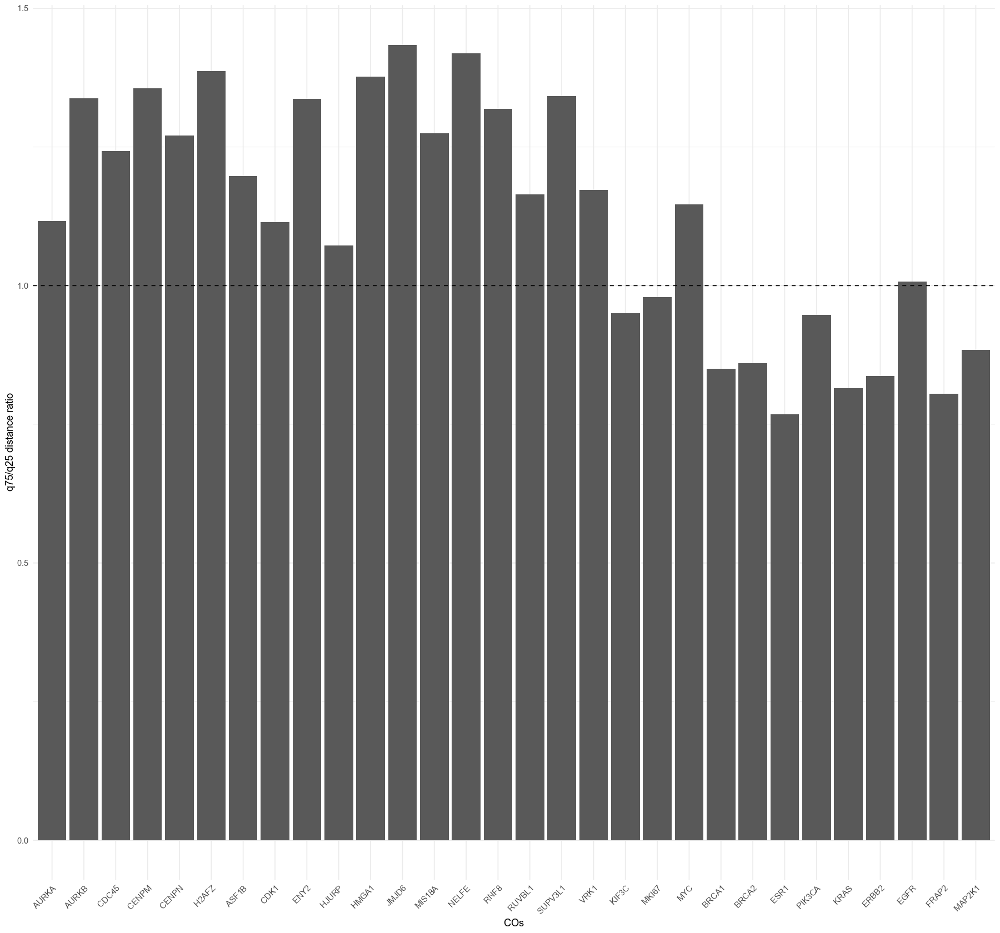

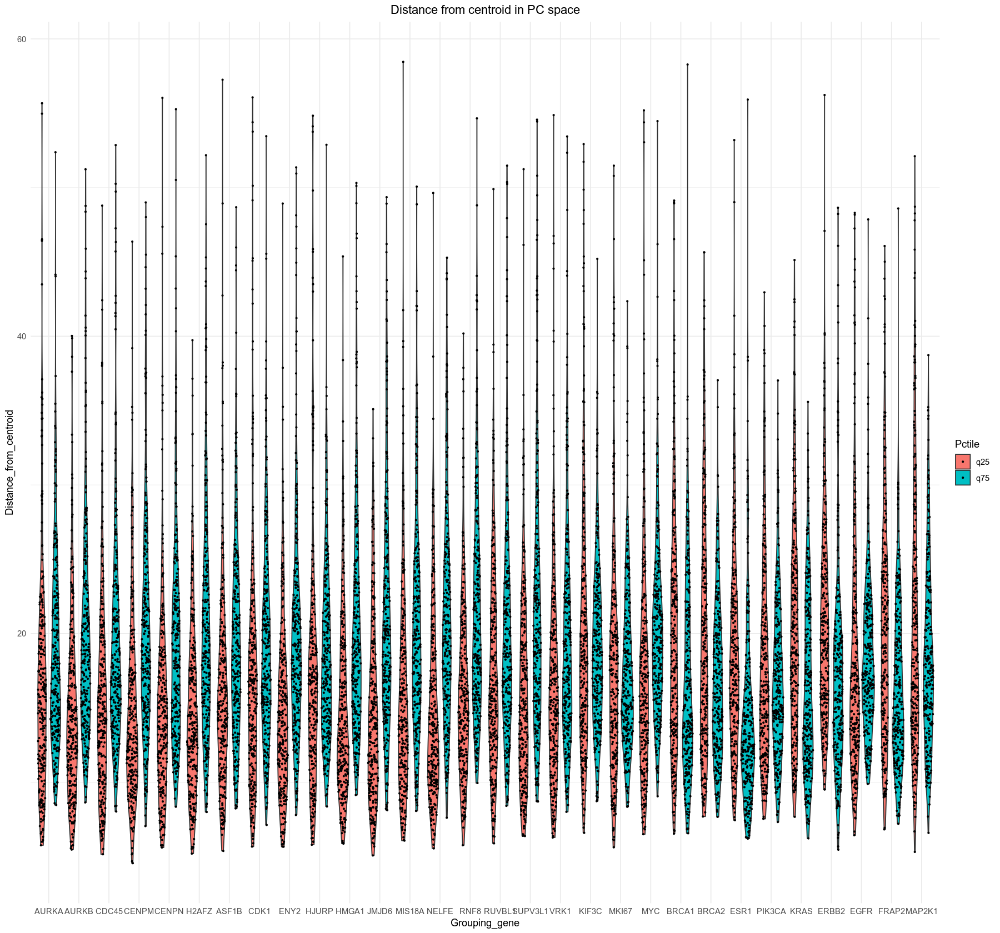

In [38]:
### show barplot of all genes > 10 FPKM PC distances ###

cluster_distances_PCA_all_genes_q25_q75[genes_to_graph,] -> PC_distances_select

PC_distances_select <- pivot_longer(PC_distances_select, names_to = 'Pctile', values_to = 'distance', cols = ends_with('pctile'))
PC_distances_select$Pctile = factor(PC_distances_select$Pctile, levels = c('lower_pctile', 'higher_pctile'))
PC_distances_select$COs = factor(PC_distances_select$COs, levels = genes_to_graph)

PC_distances_select = PC_distances_select %>% select(COs, high_to_low_ratio) %>% distinct(COs, high_to_low_ratio, .keep_all = TRUE)
ggplot(PC_distances_select, aes(COs, high_to_low_ratio)) + ylab('q75/q25 distance ratio') +
  geom_bar(stat="identity", position=position_dodge()) + theme_minimal() + theme(axis.text.x = element_text(angle = 45, hjust = 1)) + geom_hline(yintercept = 1, linetype = 'dashed')

### show sina plot of distances for 6 genes + all Brian's hits
## later on recalculate the distance metric using say the top 5 PCs or so to get
## better separation in this sina plot
distances_final_q25_q75_PCA_all_genes[genes_to_graph] -> selected_gene_distances
lowers_select <- lapply(selected_gene_distances, '[[', 1)
uppers_select <- lapply(selected_gene_distances, '[[', 2)
lapply(genes_to_graph, rep, length(lowers_select[[1]])) -> tmp
grps <- unlist(tmp)
PCA_q25_q75_sina_df <- data.frame(Grouping_gene = grps, Pctile = c(rep('q25', length(unlist(lowers_select))), rep('q75', length(unlist(uppers_select)))), Distance_from_centroid = c(unlist(lowers_select), unlist(uppers_select)))
PCA_q25_q75_sina_df$Grouping_gene = factor(PCA_q25_q75_sina_df$Grouping_gene, levels = genes_to_graph)

ggplot(PCA_q25_q75_sina_df, aes(Grouping_gene, Distance_from_centroid, fill = Pctile)) +
  geom_violin(position=position_dodge()) +
  geom_sina(position=position_dodge(), size = 0.5) +
  ggtitle('Distance from centroid in PC space') + theme_minimal() + theme(plot.title = element_text(hjust = 0.5))


## Analysis (cell cycle regressed) ##

In [39]:
### This cell runs the PCA analysis on only the top 2000 DEGs (> 10 FPKM) ###
#### edited out non-DEG genes here ####

var.genes.idx <- match(var.genes, row.names(rna_seq_seurat_regressed_cc@assays$RNA))
raw_counts_2000DEGs <- rna_seq_seurat_regressed_cc@assays$RNA@scale.data[var.genes.idx,]

### note for PCA here we are using the SVD algorithm
# The algorithm returns the same number of PCs as there are observations
## This is because SVD does not use the covariance matrix to compute PCs
rownames(raw_counts_2000DEGs) <- row.names(rna_seq_seurat@assays$RNA)[var.genes.idx]
pca1 = prcomp(t(raw_counts_2000DEGs), scale. = TRUE)
PCA_coordinates = pca1$x
PCA_coordinates_final = PCA_coordinates[, 1:50]
PCA_coordinates_final = t(PCA_coordinates_final)
PCA_coordinates_final -> PCA_coordinates_final_q25_q75_top2000DEGs
eigs <- pca1$sdev^2
eigen_values = eigs
explained_variance = eigs/sum(eigs)
explained_variance = explained_variance[1:50]

dataframe_returner <- function (key, full_data, additional_col_vectors = c(),
                                key_gene_entry = 1, key_random_entry = 2, 
                                key_25_entry = 3, key_75_entry = 4) {
  #additional_col_vectors fetches columns by name
  
  #Idea is to aggr. the columns that correspond to the 'correct' patients for each
  #quartile grouping
  q25_dataframe = full_data[, colnames(full_data) %in% c(additional_col_vectors,
                                                         key[[key_25_entry]])]
  #key_2/75_entry is a numeric index
  q75_dataframe = full_data[, colnames(full_data) %in% c(additional_col_vectors,
                                                         key[[key_75_entry]])]
  return (list(key[[key_gene_entry]], key[[key_random_entry]],
               q25_dataframe, q75_dataframe))
}

grouped_dataframes_list <- lapply(groupings, dataframe_returner, 
                                  PCA_coordinates_final)

grouped_dataframes_list_PCA_q25_q75_top2000DEGs <- grouped_dataframes_list
## groupings 494 - 543 are groupings based on random genes ##

transposer <- function(x){
  lower_pct = t(x[[3]])
  upper_pct = t(x[[4]])
  return(list(lower_pct, upper_pct))
}

grouped_dataframes_list_dist_prepped <- pblapply(grouped_dataframes_list, transposer)

library(parallelDist)

#find euclidean mean vector for cells per each drug treatment
centroid_appender <- function(x){
  lower_pct = rbind(colMeans(x[[1]]), x[[1]])
  upper_pct = rbind(colMeans(x[[2]]), x[[2]])
  return(list(lower_pct, upper_pct))
}

grouped_dataframes_list_dist_prepped2 <- pblapply(grouped_dataframes_list_dist_prepped, centroid_appender)

weighted_distance_calculator = function(x, weights) {
  dist1 = apply(x[[1]][-1,], 1, function(z, centroid) {sqrt(sum(weights*(z - centroid)^2))}, x[[1]][1,])
  dist2 = apply(x[[2]][-1,], 1, function(z, centroid) {sqrt(sum(weights*(z - centroid)^2))}, x[[2]][1,])
  return(list(dist1, dist2))
}

distances_final <- pblapply(grouped_dataframes_list_dist_prepped2, weighted_distance_calculator, explained_variance)
distances_final -> distances_final_q25_q75_PCA_top2000DEGs

mean_distance_calculator <- function(x){
  return(c(mean(as.numeric(x[[1]])), mean(as.numeric(x[[2]]))))
}

cluster_distances <- pblapply(distances_final, mean_distance_calculator)
cluster_distances <- do.call(rbind, cluster_distances)
cluster_distances <- as.data.frame(cluster_distances)
colnames(cluster_distances) <- c('lower_pctile', 'higher_pctile')
cluster_distances$high_to_low_ratio = cluster_distances$higher_pctile/cluster_distances$lower_pctile

cluster_distances <- cbind(COs = rownames(cluster_distances), cluster_distances)
cluster_distances -> cluster_distances_PCA_2000DEGs_q25_q75
#save(distances_final_q25_q75_PCA_top2000DEGs, PCA_coordinates_final_q25_q75_top2000DEGs, grouped_dataframes_list_PCA_q25_q75_top2000DEGs, cluster_distances_PCA_2000DEGs_q25_q75, file = '/home/ssobti/projects/heterogeneity_brian/output_data/distance_analysis/sample_distances_q25_q75_PCA_2000DEGs.RData')


In [40]:
### This cell runs the PCA analysis on all genes > 10 FPKM ###
#### edited out non-DEG genes here ####

raw_counts_all_genes <- rna_seq_seurat_regressed_cc@assays$RNA@scale.data

### note for PCA here we are using the SVD algorithm
# The algorithm returns the same number of PCs as there are observations
## This is because SVD does not use the covariance matrix to compute PCs
rownames(raw_counts_all_genes) <- row.names(rna_seq_seurat_regressed_cc@assays$RNA)
pca1 = prcomp(t(raw_counts_all_genes), scale. = TRUE)
PCA_coordinates = pca1$x
PCA_coordinates_final = PCA_coordinates[, 1:50]
PCA_coordinates_final = t(PCA_coordinates_final)
PCA_coordinates_final -> PCA_coordinates_final_q25_q75_all_genes
eigs <- pca1$sdev^2
eigen_values = eigs
explained_variance = eigs/sum(eigs)
explained_variance = explained_variance[1:50]

dataframe_returner <- function (key, full_data, additional_col_vectors = c(),
                                key_gene_entry = 1, key_random_entry = 2, 
                                key_25_entry = 3, key_75_entry = 4) {
  #additional_col_vectors fetches columns by name
  
  #Idea is to aggr. the columns that correspond to the 'correct' patients for each
  #quartile grouping
  q25_dataframe = full_data[, colnames(full_data) %in% c(additional_col_vectors,
                                                         key[[key_25_entry]])]
  #key_2/75_entry is a numeric index
  q75_dataframe = full_data[, colnames(full_data) %in% c(additional_col_vectors,
                                                         key[[key_75_entry]])]
  return (list(key[[key_gene_entry]], key[[key_random_entry]],
               q25_dataframe, q75_dataframe))
}

grouped_dataframes_list <- lapply(groupings, dataframe_returner, 
                                  PCA_coordinates_final)

grouped_dataframes_list_PCA_q25_q75_all_genes <- grouped_dataframes_list
## groupings 494 - 543 are groupings based on random genes ##

transposer <- function(x){
  lower_pct = t(x[[3]])
  upper_pct = t(x[[4]])
  return(list(lower_pct, upper_pct))
}

grouped_dataframes_list_dist_prepped <- pblapply(grouped_dataframes_list, transposer)

library(parallelDist)

#find euclidean mean vector for cells per each drug treatment
centroid_appender <- function(x){
  lower_pct = rbind(colMeans(x[[1]]), x[[1]])
  upper_pct = rbind(colMeans(x[[2]]), x[[2]])
  return(list(lower_pct, upper_pct))
}

grouped_dataframes_list_dist_prepped2 <- pblapply(grouped_dataframes_list_dist_prepped, centroid_appender)

weighted_distance_calculator = function(x, weights) {
  dist1 = apply(x[[1]][-1,], 1, function(z, centroid) {sqrt(sum(weights*(z - centroid)^2))}, x[[1]][1,])
  dist2 = apply(x[[2]][-1,], 1, function(z, centroid) {sqrt(sum(weights*(z - centroid)^2))}, x[[2]][1,])
  return(list(dist1, dist2))
}

distances_final <- pblapply(grouped_dataframes_list_dist_prepped2, weighted_distance_calculator, explained_variance)
distances_final -> distances_final_q25_q75_PCA_all_genes

mean_distance_calculator <- function(x){
  return(c(mean(as.numeric(x[[1]])), mean(as.numeric(x[[2]]))))
}

cluster_distances <- pblapply(distances_final, mean_distance_calculator)
cluster_distances <- do.call(rbind, cluster_distances)
cluster_distances <- as.data.frame(cluster_distances)
colnames(cluster_distances) <- c('lower_pctile', 'higher_pctile')
cluster_distances$high_to_low_ratio = cluster_distances$higher_pctile/cluster_distances$lower_pctile

cluster_distances <- cbind(COs = rownames(cluster_distances), cluster_distances)
cluster_distances -> cluster_distances_PCA_all_genes_q25_q75
#save(distances_final_q25_q75_PCA_all_genes, PCA_coordinates_final_q25_q75_all_genes, grouped_dataframes_list_PCA_q25_q75_all_genes, cluster_distances_PCA_all_genes_q25_q75, file = '/home/ssobti/projects/heterogeneity_brian/output_data/distance_analysis/sample_distances_q25_q75_PCA_2000DEGs.RData')

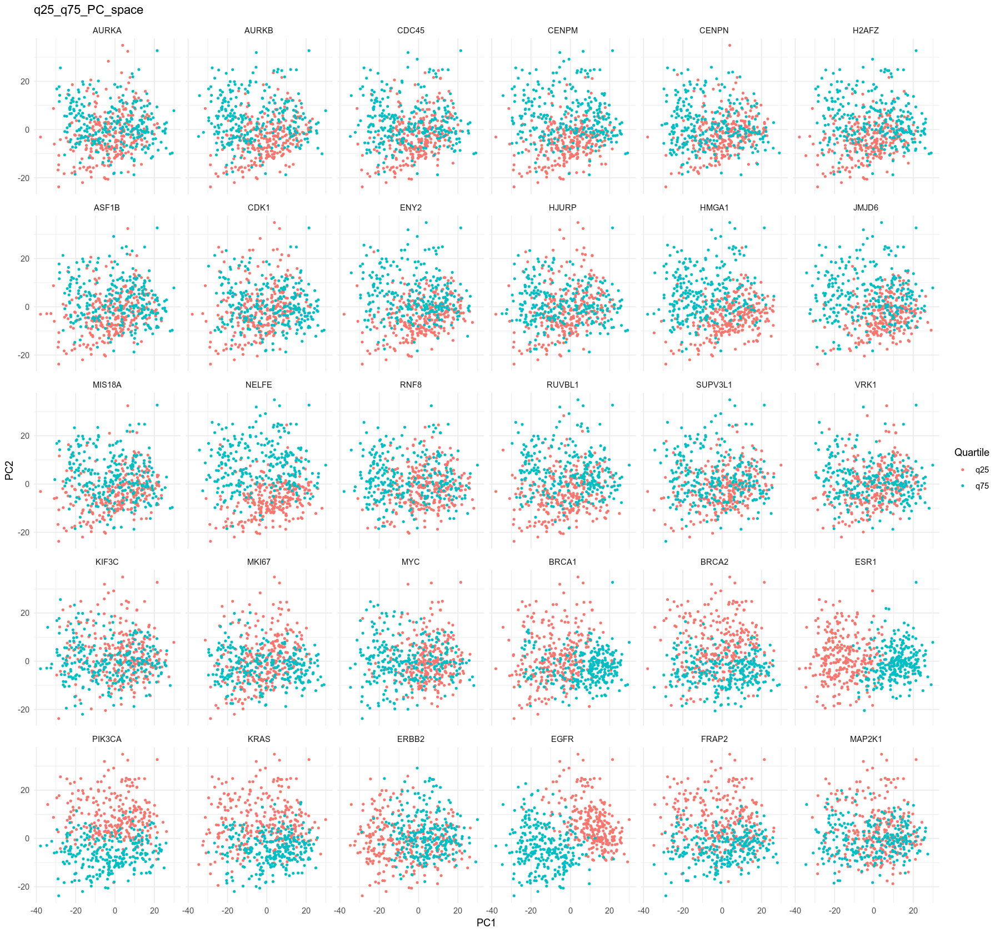

In [41]:
## extract CO and random gene indentity
gene_ident <- unlist(lapply(groupings, '[[', 2))
gene_ident[gene_ident == 'N'] <- 'CO'
gene_ident[gene_ident == 'Y'] <- 'Random'


## select out best hits and graph the q25 and q75 alone via color
## also graph a random grouping as control
## selected random gene = KIF3C
### genes to showcase = AURKA, AURKB, CDC45, CENPM, CENPN, H2AFZ
genes_to_graph = c('AURKA', 'AURKB', 'CDC45', 'CENPM', 'CENPN', 'H2AFZ', 'ASF1B', 'CDK1', 'ENY2', 'HJURP', 'HMGA1', 'JMJD6', 'MIS18A', 'NELFE', 'RNF8', 'RUVBL1', 'SUPV3L1', 'VRK1', 'KIF3C', 'MKI67', 'MYC', 'BRCA1', 'BRCA2', 'ESR1', 'PIK3CA', 'KRAS', 'ERBB2', 'EGFR', 'FRAP2', 'MAP2K1')

## q25 vs q75 graphs in PCA space
names(grouped_dataframes_list_PCA_q25_q75_top2000DEGs) <- cluster_distances_PCA_2000DEGs_q25_q75$COs
lowers <- lapply(grouped_dataframes_list_PCA_q25_q75_top2000DEGs, '[[', 3)
uppers <- lapply(grouped_dataframes_list_PCA_q25_q75_top2000DEGs, '[[', 4)
lowers_select <- lowers[genes_to_graph]
uppers_select <- uppers[genes_to_graph]
lowers_select <- lapply(lowers_select, t)
uppers_select <- lapply(uppers_select, t)
lowers_select <- lapply(lowers_select, as.data.frame)
uppers_select <- lapply(uppers_select, as.data.frame)
lowers_select <- lapply(lowers_select, select, PC1, PC2)
uppers_select <- lapply(uppers_select, select, PC1, PC2)
lowers_select <- lapply(lowers_select, mutate, Quartile = 'q25')
uppers_select <- lapply(uppers_select, mutate, Quartile = 'q75')
combined <- mapply(rbind, lowers_select, uppers_select, SIMPLIFY = FALSE)
q25_q75_PCA_df <- bind_rows(combined, .id = 'Grouping_gene')
q25_q75_PCA_df$Grouping_gene = factor(q25_q75_PCA_df$Grouping_gene, levels = genes_to_graph)

ggplot(q25_q75_PCA_df, aes(PC1, PC2, color = Quartile)) + geom_point(alpha = 1, size = 0.8) + facet_wrap(~Grouping_gene) + theme_minimal() +
  ggtitle('q25_q75_PC_space')

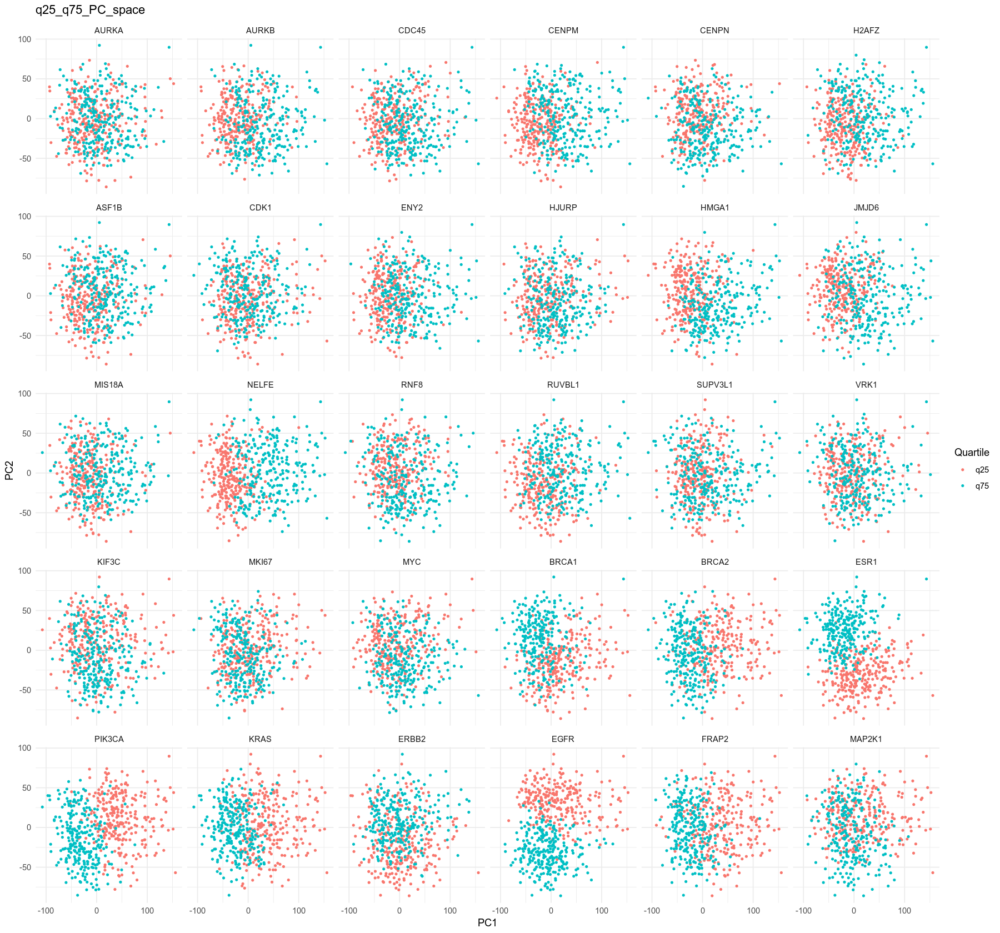

In [42]:
## extract CO and random gene indentity
gene_ident <- unlist(lapply(groupings, '[[', 2))
gene_ident[gene_ident == 'N'] <- 'CO'
gene_ident[gene_ident == 'Y'] <- 'Random'


## select out best hits and graph the q25 and q75 alone via color
## also graph a random grouping as control
## selected random gene = KIF3C
### genes to showcase = AURKA, AURKB, CDC45, CENPM, CENPN, H2AFZ
genes_to_graph = c('AURKA', 'AURKB', 'CDC45', 'CENPM', 'CENPN', 'H2AFZ', 'ASF1B', 'CDK1', 'ENY2', 'HJURP', 'HMGA1', 'JMJD6', 'MIS18A', 'NELFE', 'RNF8', 'RUVBL1', 'SUPV3L1', 'VRK1', 'KIF3C', 'MKI67', 'MYC', 'BRCA1', 'BRCA2', 'ESR1', 'PIK3CA', 'KRAS', 'ERBB2', 'EGFR', 'FRAP2', 'MAP2K1')

## q25 vs q75 graphs in PCA space
names(grouped_dataframes_list_PCA_q25_q75_all_genes) <- cluster_distances_PCA_all_genes_q25_q75$COs
lowers <- lapply(grouped_dataframes_list_PCA_q25_q75_all_genes, '[[', 3)
uppers <- lapply(grouped_dataframes_list_PCA_q25_q75_all_genes, '[[', 4)
lowers_select <- lowers[genes_to_graph]
uppers_select <- uppers[genes_to_graph]
lowers_select <- lapply(lowers_select, t)
uppers_select <- lapply(uppers_select, t)
lowers_select <- lapply(lowers_select, as.data.frame)
uppers_select <- lapply(uppers_select, as.data.frame)
lowers_select <- lapply(lowers_select, select, PC1, PC2)
uppers_select <- lapply(uppers_select, select, PC1, PC2)
lowers_select <- lapply(lowers_select, mutate, Quartile = 'q25')
uppers_select <- lapply(uppers_select, mutate, Quartile = 'q75')
combined <- mapply(rbind, lowers_select, uppers_select, SIMPLIFY = FALSE)
q25_q75_PCA_df <- bind_rows(combined, .id = 'Grouping_gene')
q25_q75_PCA_df$Grouping_gene = factor(q25_q75_PCA_df$Grouping_gene, levels = genes_to_graph)

ggplot(q25_q75_PCA_df, aes(PC1, PC2, color = Quartile)) + geom_point(alpha = 1, size = 0.8) + facet_wrap(~Grouping_gene) + theme_minimal() +
  ggtitle('q25_q75_PC_space')

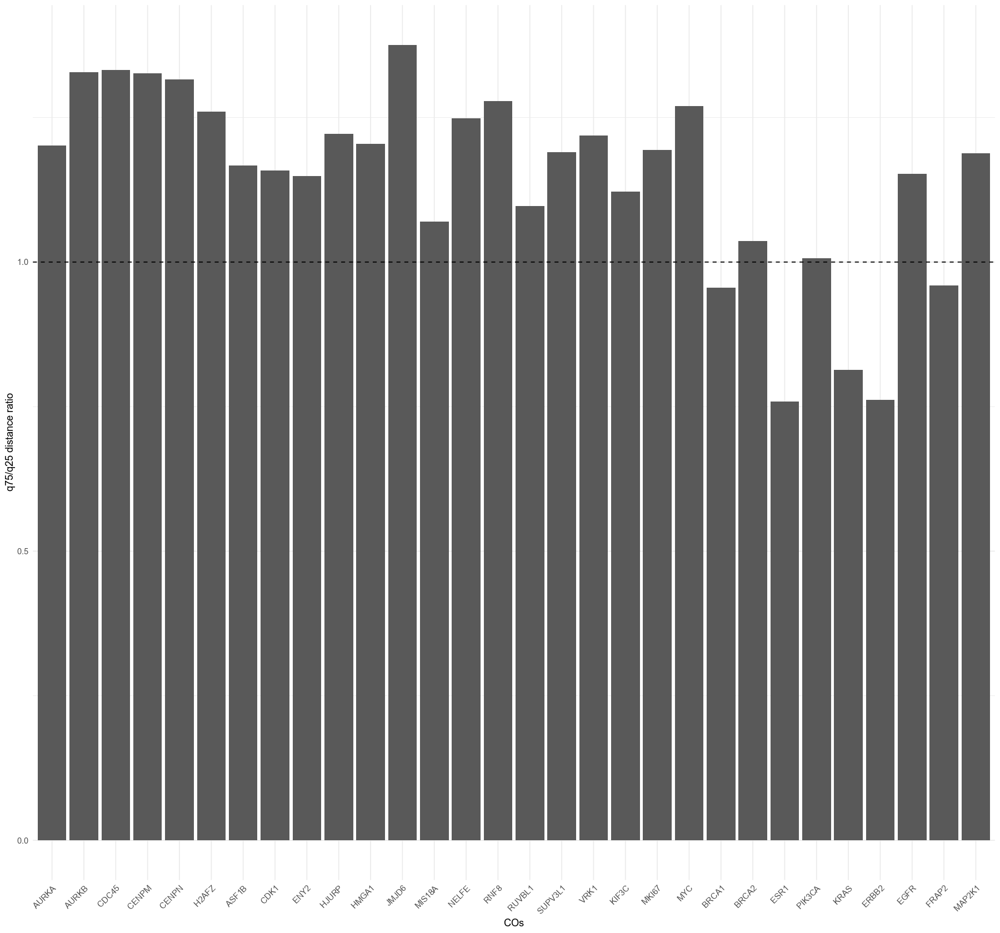

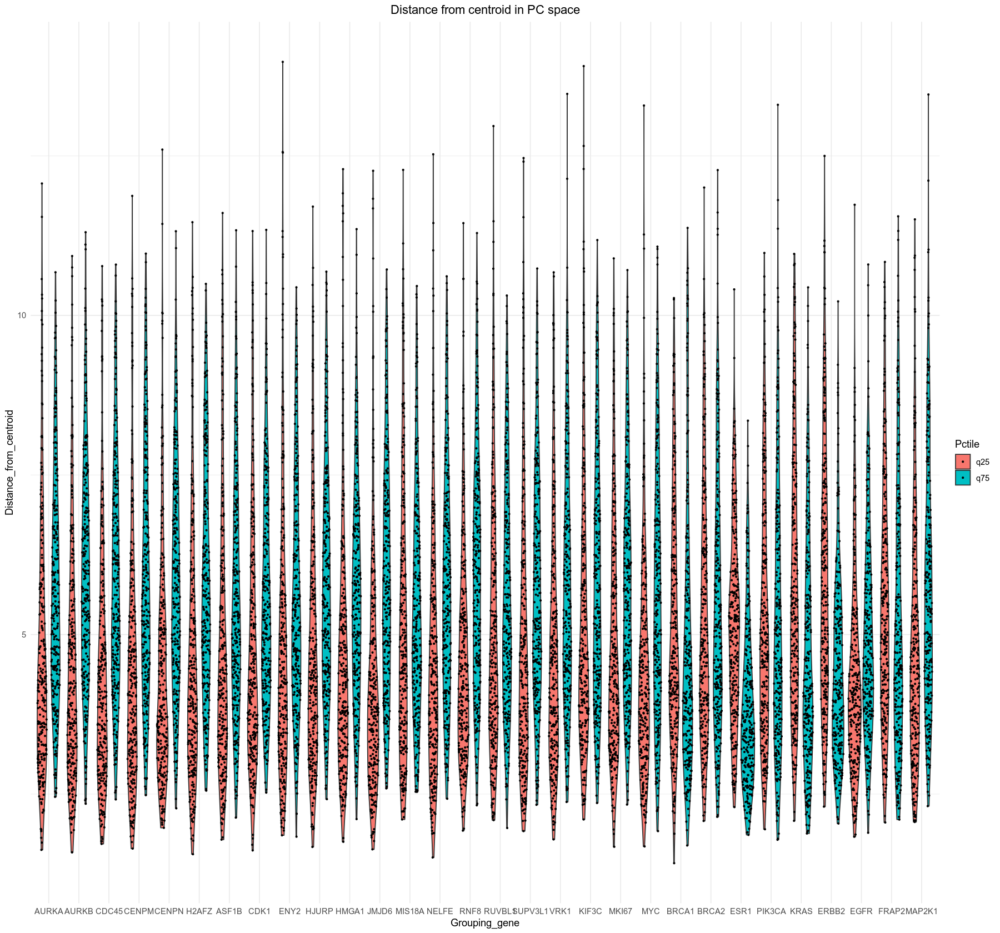

In [43]:
### show barplot of 2000 DEGs > 10 FPKM PC distances ###

cluster_distances_PCA_2000DEGs_q25_q75[genes_to_graph,] -> PC_distances_select

PC_distances_select <- pivot_longer(PC_distances_select, names_to = 'Pctile', values_to = 'distance', cols = ends_with('pctile'))
PC_distances_select$Pctile = factor(PC_distances_select$Pctile, levels = c('lower_pctile', 'higher_pctile'))
PC_distances_select$COs = factor(PC_distances_select$COs, levels = genes_to_graph)

PC_distances_select = PC_distances_select %>% select(COs, high_to_low_ratio) %>% distinct(COs, high_to_low_ratio, .keep_all = TRUE)
ggplot(PC_distances_select, aes(COs, high_to_low_ratio)) + ylab('q75/q25 distance ratio') +
  geom_bar(stat="identity", position=position_dodge()) + theme_minimal() + theme(axis.text.x = element_text(angle = 45, hjust = 1)) + geom_hline(yintercept = 1, linetype = 'dashed')

### show sina plot of distances for 6 genes + all Brian's hits
## later on recalculate the distance metric using say the top 5 PCs or so to get
## better separation in this sina plot
distances_final_q25_q75_PCA_top2000DEGs[genes_to_graph] -> selected_gene_distances
lowers_select <- lapply(selected_gene_distances, '[[', 1)
uppers_select <- lapply(selected_gene_distances, '[[', 2)
lapply(genes_to_graph, rep, length(lowers_select[[1]])) -> tmp
grps <- unlist(tmp)
PCA_q25_q75_sina_df <- data.frame(Grouping_gene = grps, Pctile = c(rep('q25', length(unlist(lowers_select))), rep('q75', length(unlist(uppers_select)))), Distance_from_centroid = c(unlist(lowers_select), unlist(uppers_select)))
PCA_q25_q75_sina_df$Grouping_gene = factor(PCA_q25_q75_sina_df$Grouping_gene, levels = genes_to_graph)

ggplot(PCA_q25_q75_sina_df, aes(Grouping_gene, Distance_from_centroid, fill = Pctile)) +
  geom_violin(position=position_dodge()) +
  geom_sina(position=position_dodge(), size = 0.5) +
  ggtitle('Distance from centroid in PC space') + theme_minimal() + theme(plot.title = element_text(hjust = 0.5))



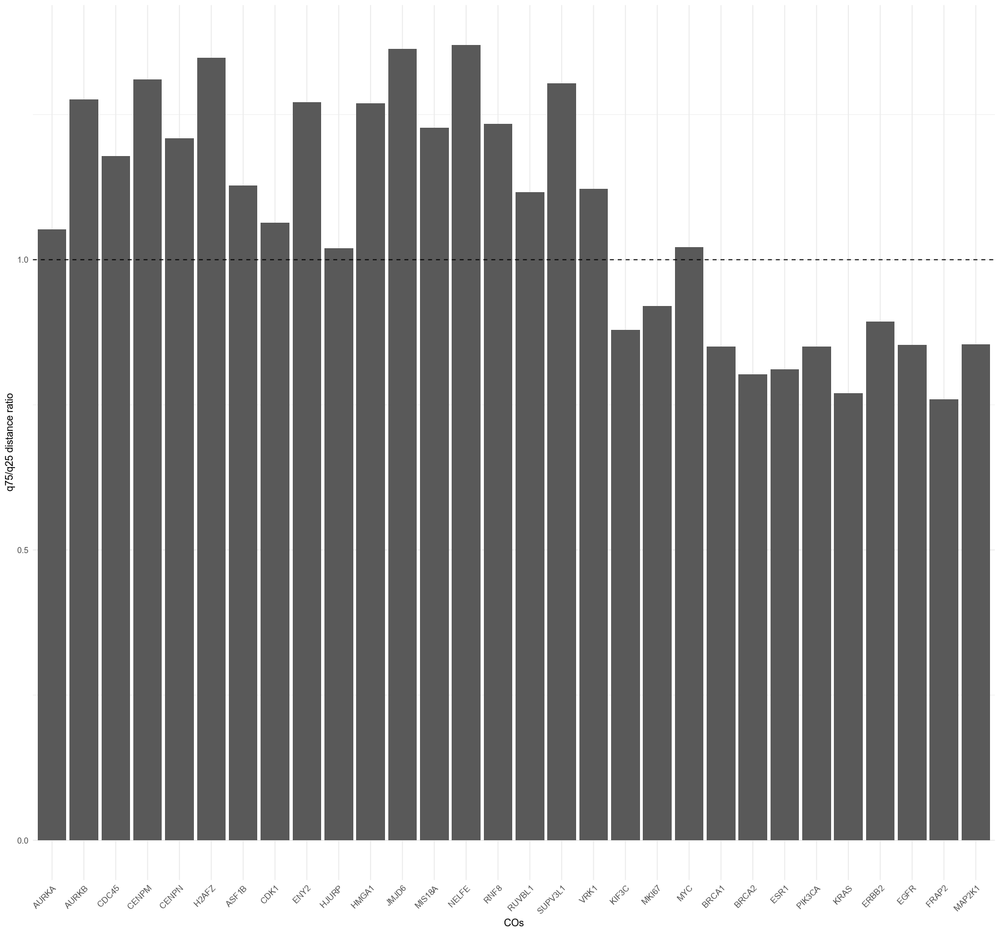

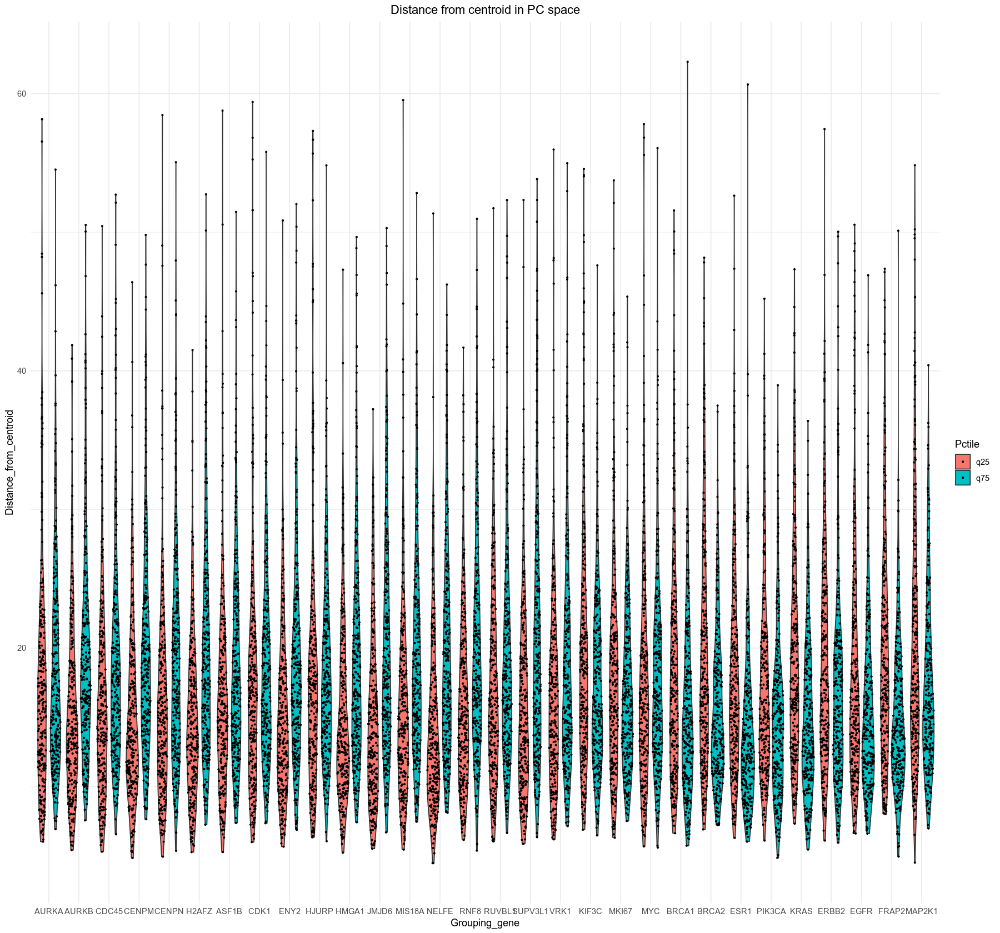

In [44]:
### show barplot of all genes > 10 FPKM PC distances ###

cluster_distances_PCA_all_genes_q25_q75[genes_to_graph,] -> PC_distances_select

PC_distances_select <- pivot_longer(PC_distances_select, names_to = 'Pctile', values_to = 'distance', cols = ends_with('pctile'))
PC_distances_select$Pctile = factor(PC_distances_select$Pctile, levels = c('lower_pctile', 'higher_pctile'))
PC_distances_select$COs = factor(PC_distances_select$COs, levels = genes_to_graph)

PC_distances_select = PC_distances_select %>% select(COs, high_to_low_ratio) %>% distinct(COs, high_to_low_ratio, .keep_all = TRUE)
ggplot(PC_distances_select, aes(COs, high_to_low_ratio)) + ylab('q75/q25 distance ratio') +
  geom_bar(stat="identity", position=position_dodge()) + theme_minimal() + theme(axis.text.x = element_text(angle = 45, hjust = 1)) + geom_hline(yintercept = 1, linetype = 'dashed')

### show sina plot of distances for 6 genes + all Brian's hits
## later on recalculate the distance metric using say the top 5 PCs or so to get
## better separation in this sina plot
distances_final_q25_q75_PCA_all_genes[genes_to_graph] -> selected_gene_distances
lowers_select <- lapply(selected_gene_distances, '[[', 1)
uppers_select <- lapply(selected_gene_distances, '[[', 2)
lapply(genes_to_graph, rep, length(lowers_select[[1]])) -> tmp
grps <- unlist(tmp)
PCA_q25_q75_sina_df <- data.frame(Grouping_gene = grps, Pctile = c(rep('q25', length(unlist(lowers_select))), rep('q75', length(unlist(uppers_select)))), Distance_from_centroid = c(unlist(lowers_select), unlist(uppers_select)))
PCA_q25_q75_sina_df$Grouping_gene = factor(PCA_q25_q75_sina_df$Grouping_gene, levels = genes_to_graph)

ggplot(PCA_q25_q75_sina_df, aes(Grouping_gene, Distance_from_centroid, fill = Pctile)) +
  geom_violin(position=position_dodge()) +
  geom_sina(position=position_dodge(), size = 0.5) +
  ggtitle('Distance from centroid in PC space') + theme_minimal() + theme(plot.title = element_text(hjust = 0.5))


## Analysis (cell cycle G2M and S phase difference regressed out) ##

In [45]:
### This cell runs the PCA analysis on only the top 2000 DEGs (> 10 FPKM) ###
#### edited out non-DEG genes here ####

var.genes.idx <- match(var.genes, row.names(rna_seq_seurat_regressed_cc_G2M_S_diff@assays$RNA))
raw_counts_2000DEGs <- rna_seq_seurat_regressed_cc_G2M_S_diff@assays$RNA@scale.data[var.genes.idx,]

### note for PCA here we are using the SVD algorithm
# The algorithm returns the same number of PCs as there are observations
## This is because SVD does not use the covariance matrix to compute PCs
rownames(raw_counts_2000DEGs) <- row.names(rna_seq_seurat_regressed_cc_G2M_S_diff@assays$RNA)[var.genes.idx]
pca1 = prcomp(t(raw_counts_2000DEGs), scale. = TRUE)
PCA_coordinates = pca1$x
PCA_coordinates_final = PCA_coordinates[, 1:50]
PCA_coordinates_final = t(PCA_coordinates_final)
PCA_coordinates_final -> PCA_coordinates_final_q25_q75_top2000DEGs
eigs <- pca1$sdev^2
eigen_values = eigs
explained_variance = eigs/sum(eigs)
explained_variance = explained_variance[1:50]

dataframe_returner <- function (key, full_data, additional_col_vectors = c(),
                                key_gene_entry = 1, key_random_entry = 2, 
                                key_25_entry = 3, key_75_entry = 4) {
  #additional_col_vectors fetches columns by name
  
  #Idea is to aggr. the columns that correspond to the 'correct' patients for each
  #quartile grouping
  q25_dataframe = full_data[, colnames(full_data) %in% c(additional_col_vectors,
                                                         key[[key_25_entry]])]
  #key_2/75_entry is a numeric index
  q75_dataframe = full_data[, colnames(full_data) %in% c(additional_col_vectors,
                                                         key[[key_75_entry]])]
  return (list(key[[key_gene_entry]], key[[key_random_entry]],
               q25_dataframe, q75_dataframe))
}

grouped_dataframes_list <- lapply(groupings, dataframe_returner, 
                                  PCA_coordinates_final)

grouped_dataframes_list_PCA_q25_q75_top2000DEGs <- grouped_dataframes_list
## groupings 494 - 543 are groupings based on random genes ##

transposer <- function(x){
  lower_pct = t(x[[3]])
  upper_pct = t(x[[4]])
  return(list(lower_pct, upper_pct))
}

grouped_dataframes_list_dist_prepped <- pblapply(grouped_dataframes_list, transposer)

library(parallelDist)

#find euclidean mean vector for cells per each drug treatment
centroid_appender <- function(x){
  lower_pct = rbind(colMeans(x[[1]]), x[[1]])
  upper_pct = rbind(colMeans(x[[2]]), x[[2]])
  return(list(lower_pct, upper_pct))
}

grouped_dataframes_list_dist_prepped2 <- pblapply(grouped_dataframes_list_dist_prepped, centroid_appender)

weighted_distance_calculator = function(x, weights) {
  dist1 = apply(x[[1]][-1,], 1, function(z, centroid) {sqrt(sum(weights*(z - centroid)^2))}, x[[1]][1,])
  dist2 = apply(x[[2]][-1,], 1, function(z, centroid) {sqrt(sum(weights*(z - centroid)^2))}, x[[2]][1,])
  return(list(dist1, dist2))
}

distances_final <- pblapply(grouped_dataframes_list_dist_prepped2, weighted_distance_calculator, explained_variance)
distances_final -> distances_final_q25_q75_PCA_top2000DEGs

mean_distance_calculator <- function(x){
  return(c(mean(as.numeric(x[[1]])), mean(as.numeric(x[[2]]))))
}

cluster_distances <- pblapply(distances_final, mean_distance_calculator)
cluster_distances <- do.call(rbind, cluster_distances)
cluster_distances <- as.data.frame(cluster_distances)
colnames(cluster_distances) <- c('lower_pctile', 'higher_pctile')
cluster_distances$high_to_low_ratio = cluster_distances$higher_pctile/cluster_distances$lower_pctile

cluster_distances <- cbind(COs = rownames(cluster_distances), cluster_distances)
cluster_distances -> cluster_distances_PCA_2000DEGs_q25_q75
#save(distances_final_q25_q75_PCA_top2000DEGs, PCA_coordinates_final_q25_q75_top2000DEGs, grouped_dataframes_list_PCA_q25_q75_top2000DEGs, cluster_distances_PCA_2000DEGs_q25_q75, file = '/home/ssobti/projects/heterogeneity_brian/output_data/distance_analysis/sample_distances_q25_q75_PCA_2000DEGs.RData')


In [46]:
### This cell runs the PCA analysis on all genes > 10 FPKM ###
#### edited out non-DEG genes here ####

raw_counts_all_genes <- rna_seq_seurat_regressed_cc_G2M_S_diff@assays$RNA@scale.data

### note for PCA here we are using the SVD algorithm
# The algorithm returns the same number of PCs as there are observations
## This is because SVD does not use the covariance matrix to compute PCs
rownames(raw_counts_all_genes) <- row.names(rna_seq_seurat_regressed_cc_G2M_S_diff@assays$RNA)
pca1 = prcomp(t(raw_counts_all_genes), scale. = TRUE)
PCA_coordinates = pca1$x
PCA_coordinates_final = PCA_coordinates[, 1:50]
PCA_coordinates_final = t(PCA_coordinates_final)
PCA_coordinates_final -> PCA_coordinates_final_q25_q75_all_genes
eigs <- pca1$sdev^2
eigen_values = eigs
explained_variance = eigs/sum(eigs)
explained_variance = explained_variance[1:50]

dataframe_returner <- function (key, full_data, additional_col_vectors = c(),
                                key_gene_entry = 1, key_random_entry = 2, 
                                key_25_entry = 3, key_75_entry = 4) {
  #additional_col_vectors fetches columns by name
  
  #Idea is to aggr. the columns that correspond to the 'correct' patients for each
  #quartile grouping
  q25_dataframe = full_data[, colnames(full_data) %in% c(additional_col_vectors,
                                                         key[[key_25_entry]])]
  #key_2/75_entry is a numeric index
  q75_dataframe = full_data[, colnames(full_data) %in% c(additional_col_vectors,
                                                         key[[key_75_entry]])]
  return (list(key[[key_gene_entry]], key[[key_random_entry]],
               q25_dataframe, q75_dataframe))
}

grouped_dataframes_list <- lapply(groupings, dataframe_returner, 
                                  PCA_coordinates_final)

grouped_dataframes_list_PCA_q25_q75_all_genes <- grouped_dataframes_list
## groupings 494 - 543 are groupings based on random genes ##

transposer <- function(x){
  lower_pct = t(x[[3]])
  upper_pct = t(x[[4]])
  return(list(lower_pct, upper_pct))
}

grouped_dataframes_list_dist_prepped <- pblapply(grouped_dataframes_list, transposer)

library(parallelDist)

#find euclidean mean vector for cells per each drug treatment
centroid_appender <- function(x){
  lower_pct = rbind(colMeans(x[[1]]), x[[1]])
  upper_pct = rbind(colMeans(x[[2]]), x[[2]])
  return(list(lower_pct, upper_pct))
}

grouped_dataframes_list_dist_prepped2 <- pblapply(grouped_dataframes_list_dist_prepped, centroid_appender)

weighted_distance_calculator = function(x, weights) {
  dist1 = apply(x[[1]][-1,], 1, function(z, centroid) {sqrt(sum(weights*(z - centroid)^2))}, x[[1]][1,])
  dist2 = apply(x[[2]][-1,], 1, function(z, centroid) {sqrt(sum(weights*(z - centroid)^2))}, x[[2]][1,])
  return(list(dist1, dist2))
}

distances_final <- pblapply(grouped_dataframes_list_dist_prepped2, weighted_distance_calculator, explained_variance)
distances_final -> distances_final_q25_q75_PCA_all_genes

mean_distance_calculator <- function(x){
  return(c(mean(as.numeric(x[[1]])), mean(as.numeric(x[[2]]))))
}

cluster_distances <- pblapply(distances_final, mean_distance_calculator)
cluster_distances <- do.call(rbind, cluster_distances)
cluster_distances <- as.data.frame(cluster_distances)
colnames(cluster_distances) <- c('lower_pctile', 'higher_pctile')
cluster_distances$high_to_low_ratio = cluster_distances$higher_pctile/cluster_distances$lower_pctile

cluster_distances <- cbind(COs = rownames(cluster_distances), cluster_distances)
cluster_distances -> cluster_distances_PCA_all_genes_q25_q75
#save(distances_final_q25_q75_PCA_all_genes, PCA_coordinates_final_q25_q75_all_genes, grouped_dataframes_list_PCA_q25_q75_all_genes, cluster_distances_PCA_all_genes_q25_q75, file = '/home/ssobti/projects/heterogeneity_brian/output_data/distance_analysis/sample_distances_q25_q75_PCA_2000DEGs.RData')

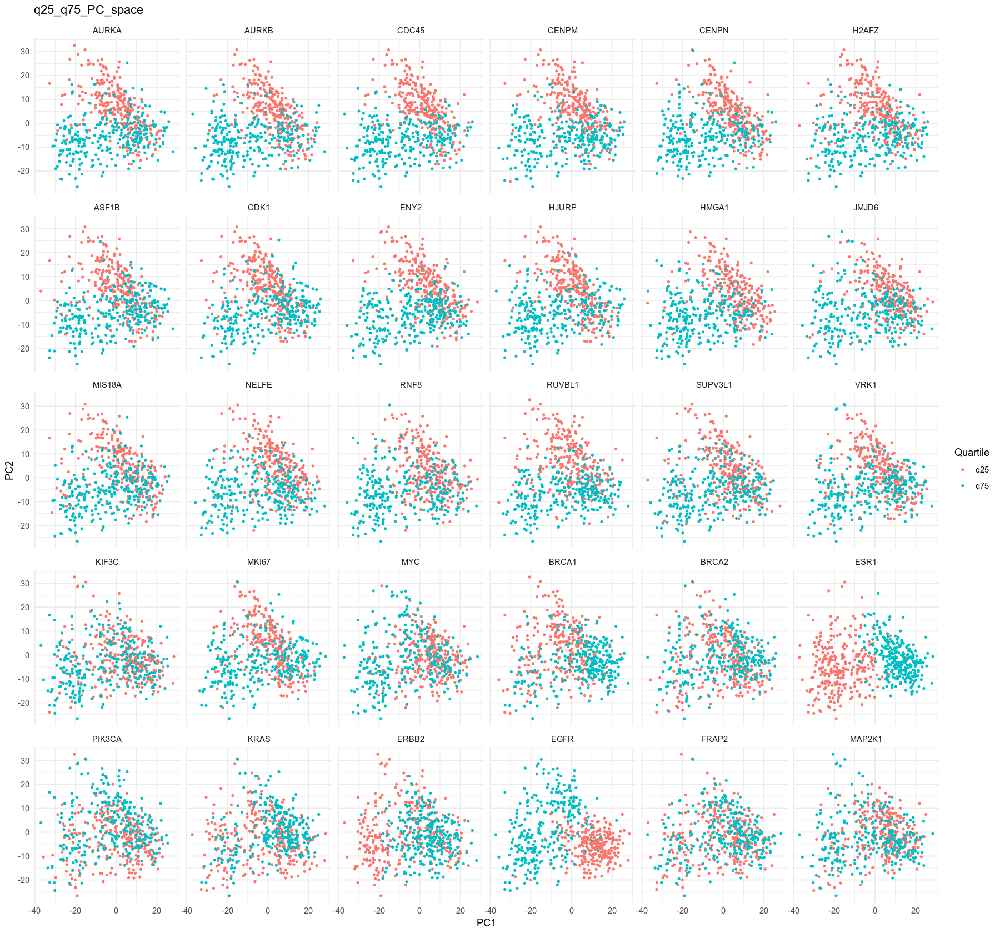

In [47]:
## extract CO and random gene indentity
gene_ident <- unlist(lapply(groupings, '[[', 2))
gene_ident[gene_ident == 'N'] <- 'CO'
gene_ident[gene_ident == 'Y'] <- 'Random'


## select out best hits and graph the q25 and q75 alone via color
## also graph a random grouping as control
## selected random gene = KIF3C
### genes to showcase = AURKA, AURKB, CDC45, CENPM, CENPN, H2AFZ
genes_to_graph = c('AURKA', 'AURKB', 'CDC45', 'CENPM', 'CENPN', 'H2AFZ', 'ASF1B', 'CDK1', 'ENY2', 'HJURP', 'HMGA1', 'JMJD6', 'MIS18A', 'NELFE', 'RNF8', 'RUVBL1', 'SUPV3L1', 'VRK1', 'KIF3C', 'MKI67', 'MYC', 'BRCA1', 'BRCA2', 'ESR1', 'PIK3CA', 'KRAS', 'ERBB2', 'EGFR', 'FRAP2', 'MAP2K1')

## q25 vs q75 graphs in PCA space
names(grouped_dataframes_list_PCA_q25_q75_top2000DEGs) <- cluster_distances_PCA_2000DEGs_q25_q75$COs
lowers <- lapply(grouped_dataframes_list_PCA_q25_q75_top2000DEGs, '[[', 3)
uppers <- lapply(grouped_dataframes_list_PCA_q25_q75_top2000DEGs, '[[', 4)
lowers_select <- lowers[genes_to_graph]
uppers_select <- uppers[genes_to_graph]
lowers_select <- lapply(lowers_select, t)
uppers_select <- lapply(uppers_select, t)
lowers_select <- lapply(lowers_select, as.data.frame)
uppers_select <- lapply(uppers_select, as.data.frame)
lowers_select <- lapply(lowers_select, select, PC1, PC2)
uppers_select <- lapply(uppers_select, select, PC1, PC2)
lowers_select <- lapply(lowers_select, mutate, Quartile = 'q25')
uppers_select <- lapply(uppers_select, mutate, Quartile = 'q75')
combined <- mapply(rbind, lowers_select, uppers_select, SIMPLIFY = FALSE)
q25_q75_PCA_df <- bind_rows(combined, .id = 'Grouping_gene')
q25_q75_PCA_df$Grouping_gene = factor(q25_q75_PCA_df$Grouping_gene, levels = genes_to_graph)

ggplot(q25_q75_PCA_df, aes(PC1, PC2, color = Quartile)) + geom_point(alpha = 1, size = 0.8) + facet_wrap(~Grouping_gene) + theme_minimal() +
  ggtitle('q25_q75_PC_space')

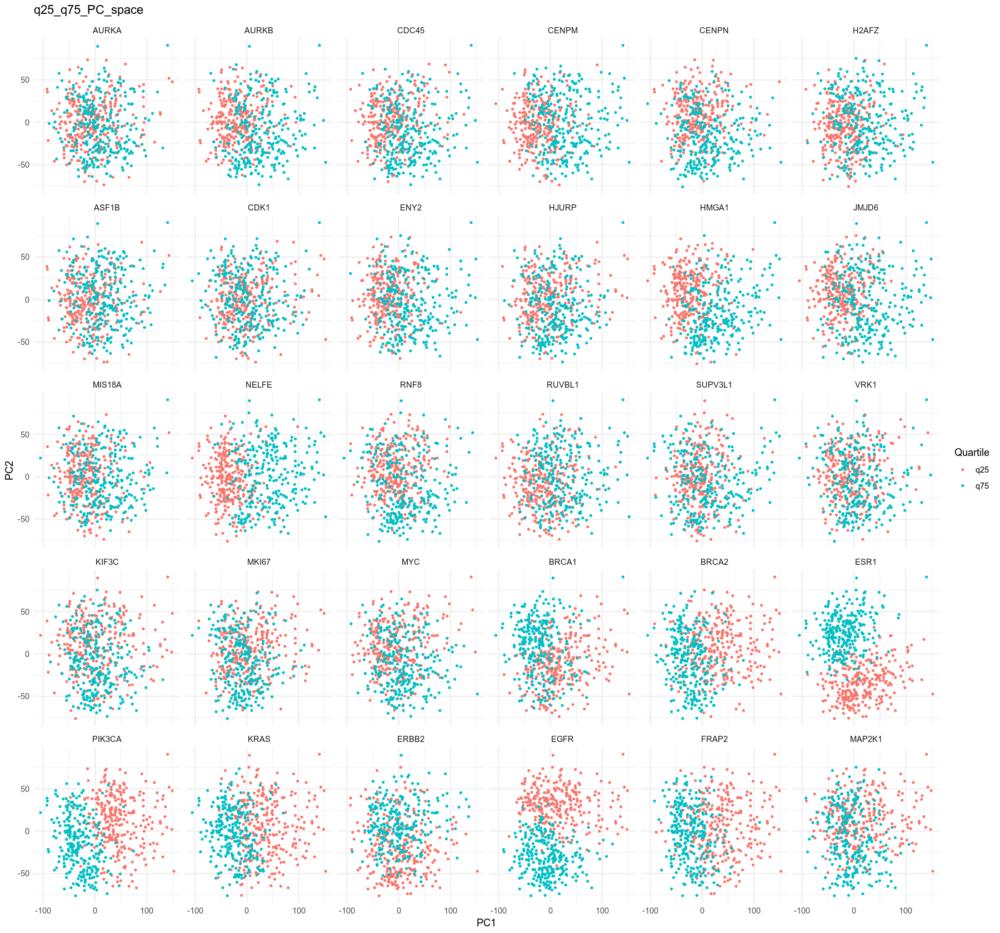

In [48]:
## extract CO and random gene indentity
gene_ident <- unlist(lapply(groupings, '[[', 2))
gene_ident[gene_ident == 'N'] <- 'CO'
gene_ident[gene_ident == 'Y'] <- 'Random'


## select out best hits and graph the q25 and q75 alone via color
## also graph a random grouping as control
## selected random gene = KIF3C
### genes to showcase = AURKA, AURKB, CDC45, CENPM, CENPN, H2AFZ
genes_to_graph = c('AURKA', 'AURKB', 'CDC45', 'CENPM', 'CENPN', 'H2AFZ', 'ASF1B', 'CDK1', 'ENY2', 'HJURP', 'HMGA1', 'JMJD6', 'MIS18A', 'NELFE', 'RNF8', 'RUVBL1', 'SUPV3L1', 'VRK1', 'KIF3C', 'MKI67', 'MYC', 'BRCA1', 'BRCA2', 'ESR1', 'PIK3CA', 'KRAS', 'ERBB2', 'EGFR', 'FRAP2', 'MAP2K1')
genes_to_graph =
## q25 vs q75 graphs in PCA space
names(grouped_dataframes_list_PCA_q25_q75_all_genes) <- cluster_distances_PCA_all_genes_q25_q75$COs
lowers <- lapply(grouped_dataframes_list_PCA_q25_q75_all_genes, '[[', 3)
uppers <- lapply(grouped_dataframes_list_PCA_q25_q75_all_genes, '[[', 4)
lowers_select <- lowers[genes_to_graph]
uppers_select <- uppers[genes_to_graph]
lowers_select <- lapply(lowers_select, t)
uppers_select <- lapply(uppers_select, t)
lowers_select <- lapply(lowers_select, as.data.frame)
uppers_select <- lapply(uppers_select, as.data.frame)
lowers_select <- lapply(lowers_select, select, PC1, PC2)
uppers_select <- lapply(uppers_select, select, PC1, PC2)
lowers_select <- lapply(lowers_select, mutate, Quartile = 'q25')
uppers_select <- lapply(uppers_select, mutate, Quartile = 'q75')
combined <- mapply(rbind, lowers_select, uppers_select, SIMPLIFY = FALSE)
q25_q75_PCA_df <- bind_rows(combined, .id = 'Grouping_gene')
q25_q75_PCA_df$Grouping_gene = factor(q25_q75_PCA_df$Grouping_gene, levels = genes_to_graph)

ggplot(q25_q75_PCA_df, aes(PC1, PC2, color = Quartile)) + geom_point(alpha = 1, size = 0.8) + facet_wrap(~Grouping_gene) + theme_minimal() +
  ggtitle('q25_q75_PC_space')

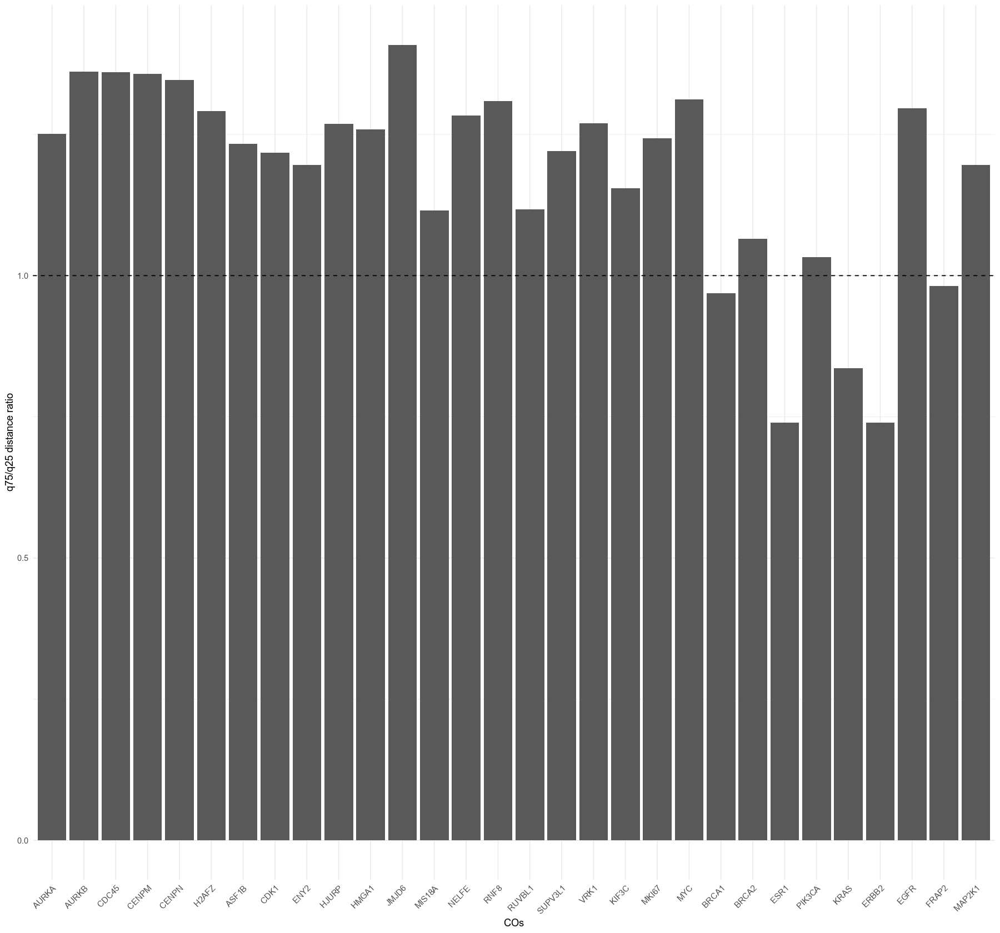

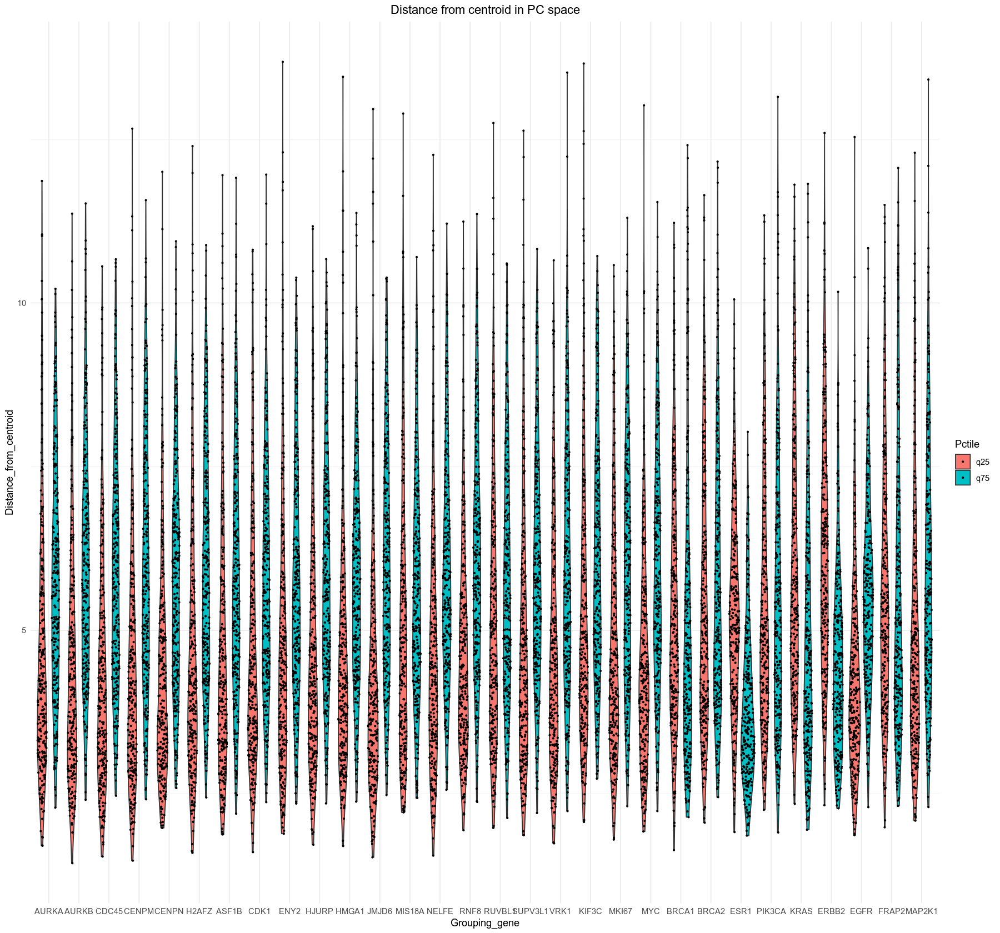

In [49]:
### show barplot of 2000 DEGs > 10 FPKM PC distances ###

cluster_distances_PCA_2000DEGs_q25_q75[genes_to_graph,] -> PC_distances_select

PC_distances_select <- pivot_longer(PC_distances_select, names_to = 'Pctile', values_to = 'distance', cols = ends_with('pctile'))
PC_distances_select$Pctile = factor(PC_distances_select$Pctile, levels = c('lower_pctile', 'higher_pctile'))
PC_distances_select$COs = factor(PC_distances_select$COs, levels = genes_to_graph)

PC_distances_select = PC_distances_select %>% select(COs, high_to_low_ratio) %>% distinct(COs, high_to_low_ratio, .keep_all = TRUE)
ggplot(PC_distances_select, aes(COs, high_to_low_ratio)) + ylab('q75/q25 distance ratio') +
  geom_bar(stat="identity", position=position_dodge()) + theme_minimal() + theme(axis.text.x = element_text(angle = 45, hjust = 1)) + geom_hline(yintercept = 1, linetype = 'dashed')

### show sina plot of distances for 6 genes + all Brian's hits
## later on recalculate the distance metric using say the top 5 PCs or so to get
## better separation in this sina plot
distances_final_q25_q75_PCA_top2000DEGs[genes_to_graph] -> selected_gene_distances
lowers_select <- lapply(selected_gene_distances, '[[', 1)
uppers_select <- lapply(selected_gene_distances, '[[', 2)
lapply(genes_to_graph, rep, length(lowers_select[[1]])) -> tmp
grps <- unlist(tmp)
PCA_q25_q75_sina_df <- data.frame(Grouping_gene = grps, Pctile = c(rep('q25', length(unlist(lowers_select))), rep('q75', length(unlist(uppers_select)))), Distance_from_centroid = c(unlist(lowers_select), unlist(uppers_select)))
PCA_q25_q75_sina_df$Grouping_gene = factor(PCA_q25_q75_sina_df$Grouping_gene, levels = genes_to_graph)

ggplot(PCA_q25_q75_sina_df, aes(Grouping_gene, Distance_from_centroid, fill = Pctile)) +
  geom_violin(position=position_dodge()) +
  geom_sina(position=position_dodge(), size = 0.5) +
  ggtitle('Distance from centroid in PC space') + theme_minimal() + theme(plot.title = element_text(hjust = 0.5))



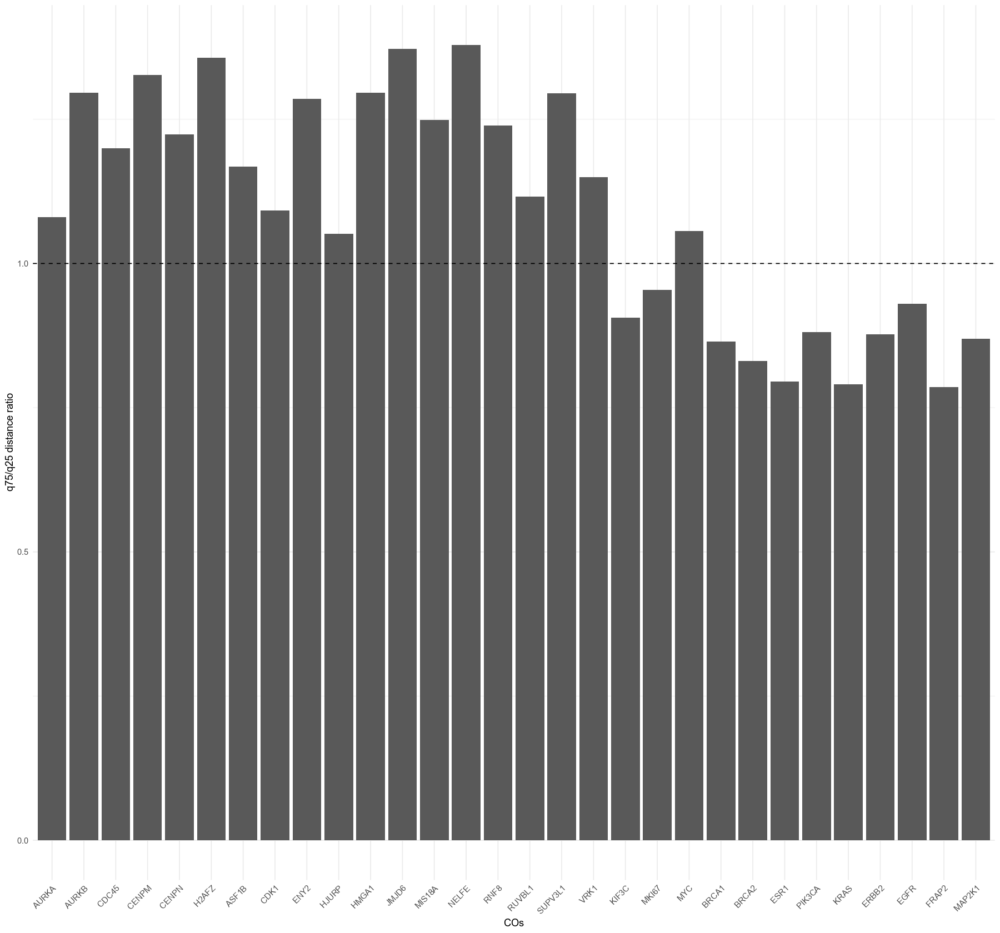

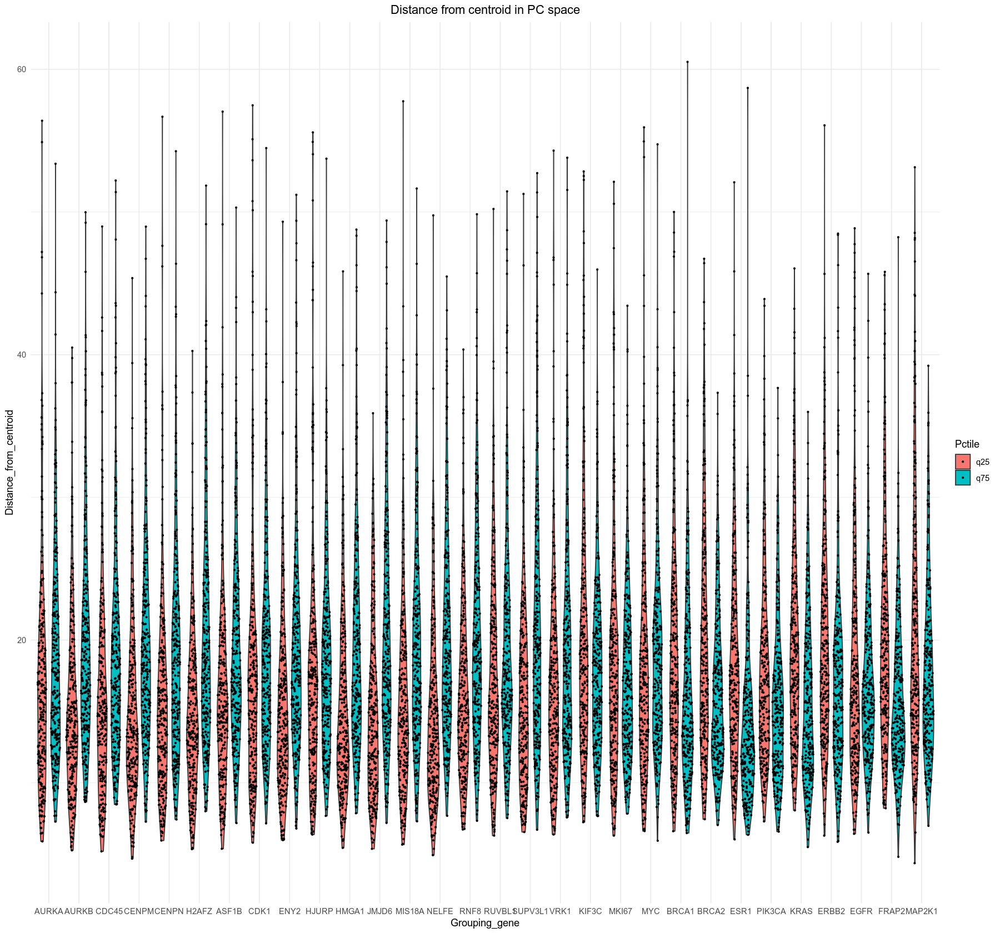

In [50]:
### show barplot of all genes > 10 FPKM PC distances ###

cluster_distances_PCA_all_genes_q25_q75[genes_to_graph,] -> PC_distances_select

PC_distances_select <- pivot_longer(PC_distances_select, names_to = 'Pctile', values_to = 'distance', cols = ends_with('pctile'))
PC_distances_select$Pctile = factor(PC_distances_select$Pctile, levels = c('lower_pctile', 'higher_pctile'))
PC_distances_select$COs = factor(PC_distances_select$COs, levels = genes_to_graph)

PC_distances_select = PC_distances_select %>% select(COs, high_to_low_ratio) %>% distinct(COs, high_to_low_ratio, .keep_all = TRUE)
ggplot(PC_distances_select, aes(COs, high_to_low_ratio)) + ylab('q75/q25 distance ratio') +
  geom_bar(stat="identity", position=position_dodge()) + theme_minimal() + theme(axis.text.x = element_text(angle = 45, hjust = 1)) + geom_hline(yintercept = 1, linetype = 'dashed')

### show sina plot of distances for 6 genes + all Brian's hits
## later on recalculate the distance metric using say the top 5 PCs or so to get
## better separation in this sina plot
distances_final_q25_q75_PCA_all_genes[genes_to_graph] -> selected_gene_distances
lowers_select <- lapply(selected_gene_distances, '[[', 1)
uppers_select <- lapply(selected_gene_distances, '[[', 2)
lapply(genes_to_graph, rep, length(lowers_select[[1]])) -> tmp
grps <- unlist(tmp)
PCA_q25_q75_sina_df <- data.frame(Grouping_gene = grps, Pctile = c(rep('q25', length(unlist(lowers_select))), rep('q75', length(unlist(uppers_select)))), Distance_from_centroid = c(unlist(lowers_select), unlist(uppers_select)))
PCA_q25_q75_sina_df$Grouping_gene = factor(PCA_q25_q75_sina_df$Grouping_gene, levels = genes_to_graph)

ggplot(PCA_q25_q75_sina_df, aes(Grouping_gene, Distance_from_centroid, fill = Pctile)) +
  geom_violin(position=position_dodge()) +
  geom_sina(position=position_dodge(), size = 0.5) +
  ggtitle('Distance from centroid in PC space') + theme_minimal() + theme(plot.title = element_text(hjust = 0.5))


In [51]:
save.image('/home/ssobti/projects/heterogeneity_brian/output_data/TCGA_nb_analysis/nb_pause_points/Regressing_out_cell_cycle_PCA_analysis/end_save2.RData')

In [52]:
#load('/home/ssobti/projects/heterogeneity_brian/output_data/TCGA_nb_analysis/nb_pause_points/Regressing_out_cell_cycle_PCA_analysis/end_save.RData')

In [53]:
#library(Seurat)
#head(VariableFeatures(rna_seq_seurat), 2000) -> var.genes

In [54]:
#saveRDS(var.genes, file = '~/projects/heterogeneity_brian/notebooks/TCGA_breast_analysis/var_genes.RDS')